In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2

La idea de este notebook es aplicar algunas ideas de algoritmos en busqueda de un algoritmo que nos permita segmentar las fresas en una imagen. Nuestra imagen base es la siguiente:

In [2]:
img = cv2.imread('Dataset/test/373.png')

Mostramos la imagen

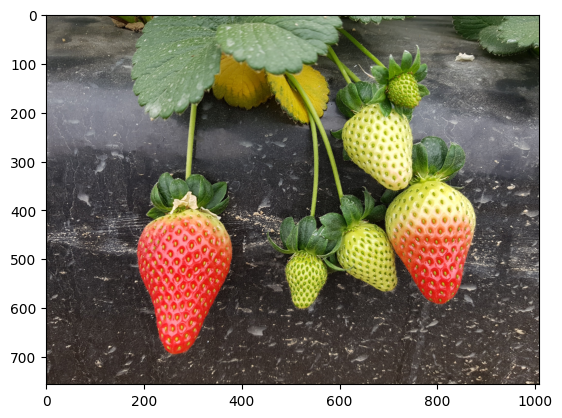

In [3]:
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

# Prueba 1:
En un notebook aparte, donde analizamos un poco los canales de color de la imagen, podemos deducir en primera medida, que el canal R puede ser de ayuda para identificar las fresas (dado que de antemano, para un objetivo posterior desecharemos las fresas verdes. Así que, en primera medida, vamos a intentar segmentar las fresas a partir del canal R.

Veamos el canal R de la imagen:

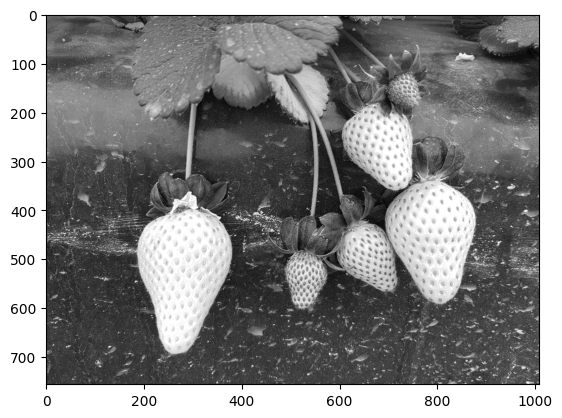

In [4]:
canal_r = img[:,:,2]

plt.imshow(canal_r, cmap='gray')

Como las fresas por sus características, pueden ser observadas con punticos que llegan a ser ruido, aplicaremos un filtrado de mediana a la imagen. 

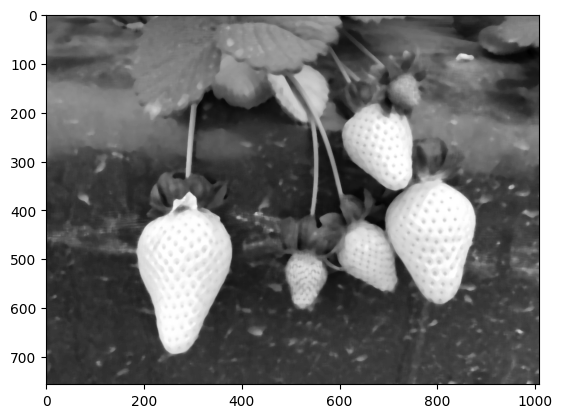

In [5]:
cr_median = cv2.medianBlur(canal_r, 9)

plt.imshow(cr_median, cmap='gray')

Vamos a aplicar un trehshold a la imagen para intentar segmentar las fresas, generando una máscara binaria.

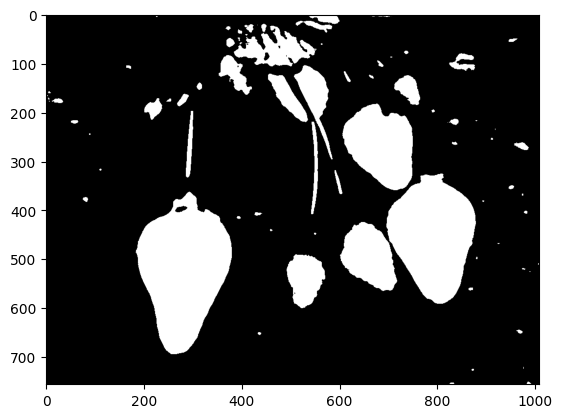

In [6]:
img_bin = cv2.threshold(cr_median, 150, 255, cv2.THRESH_BINARY)[1]

plt.imshow(img_bin, cmap='gray')

A partir de este binario, deseamos construir los bordes de las fresas. Para ello, vamos a obtener los contornos de la imagen binaria.

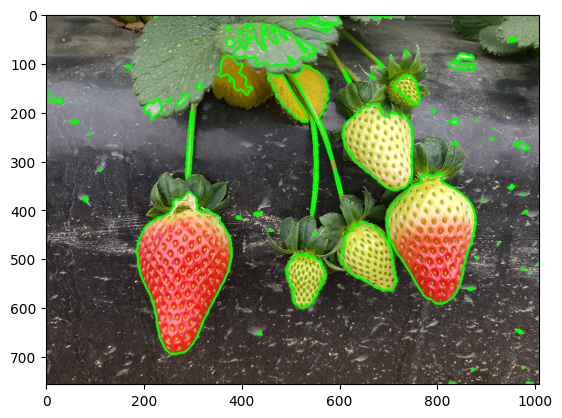

In [7]:
# Encontramos los contornos
contours, _ = cv2.findContours(img_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Creamos una copia de la imagen
img_copy = img.copy()

# Dibujamos los contornos
img_contornos = cv2.drawContours(img_copy, contours, -1, (0, 255, 0), 3)

plt.imshow(cv2.cvtColor(img_contornos, cv2.COLOR_BGR2RGB))

Notemos que cuando obtenemos los contornos, estos no son perfectos, pues traen mucho ruido. Vamos a intentar mejorarlos teniendo en cuenta que las fresas son objetos redondos. Para ello, vamos a intentar ajustar los contornos a círculos.

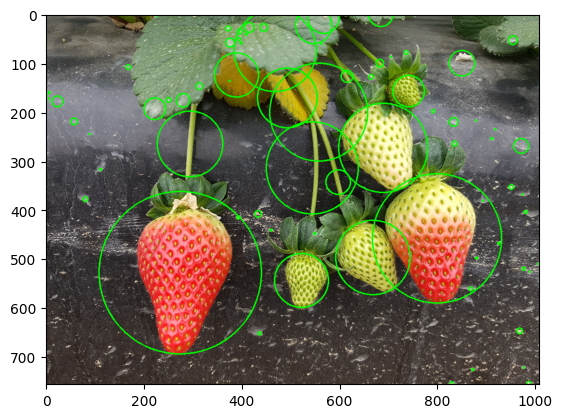

In [8]:
# Creamos una copia de la imagen
imgaux = img.copy()

# Ajustamos los contornos a círculos
for c in contours:
    # Obtenemos el centro y el radio del círculo
    ((x, y), r) = cv2.minEnclosingCircle(c)
    # Dibujamos el círculo
    cv2.circle(imgaux, (int(x), int(y)), int(r), (0, 255, 0), 2)
    
plt.imshow(cv2.cvtColor(imgaux, cv2.COLOR_BGR2RGB))

Al parecer este mecanismo no funciona. Intentemos mejor otra aproximación

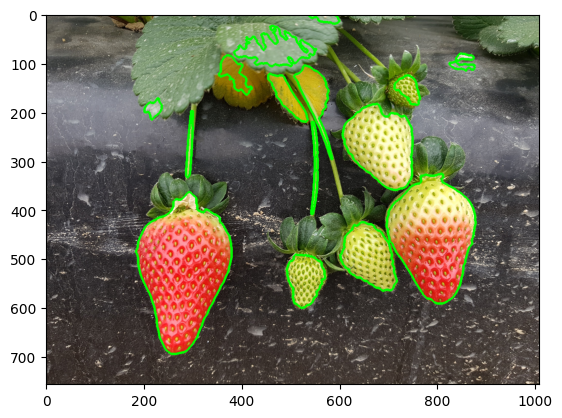

In [9]:
# Inicializa una lista para almacenar las fresas detectadas
fresas = []

# Creamos una copia de la imagen
imgaux2 = img.copy()

# Filtrar contornos
for cnt in contours:
    area = cv2.contourArea(cnt)

    # Filtrar por área
    if area > 700:  # ajustar según la escala de la imagen
        fresas.append(cnt)
        
# Dibujamos los contornos
img_contornos_2 = cv2.drawContours(imgaux2, fresas, -1, (0, 255, 0), 3)

plt.imshow(cv2.cvtColor(img_contornos_2, cv2.COLOR_BGR2RGB))

Con este mecanismo, perfectamente podríamos trabajar para la solución general que deseamos darle a nuestro problema. Sin embargo, usemos la circularidad para intentar mejorar la segmentación y eliminar los restos de hojas que se ven en la imagen.

0.6713638503798867
0.6973884054022738
0.647978286973322
0.7176678157171801
0.09118327301728085
0.1507737125070924
0.7209557501133521
0.5769710995209463
0.6077241042519583
0.45781269970297217
0.265029004330323
0.3717628852749971
0.190031525462292
0.13540290376356948
0.4248677727790233


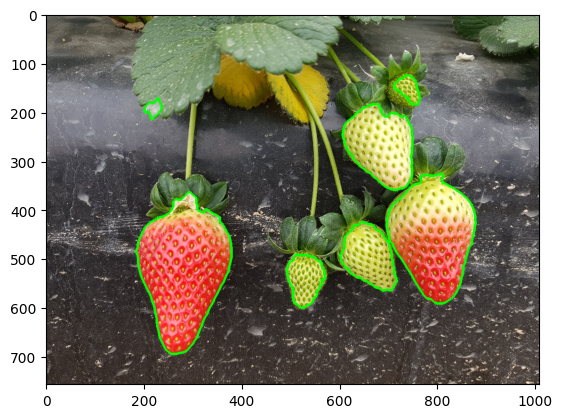

In [10]:
fresasR = []
for cnt in fresas:

  area = cv2.contourArea(cnt)
  perimetro = cv2.arcLength(cnt, True)

  if perimetro == 0:
    continue

  # Calcular circularidad
  circularidad = 4 * np.pi * (area / (perimetro ** 2))
  print(circularidad)

  # Filtrar por circularidad: valores cercanos a 1 son más circulares
  if 0.5 < circularidad < 1:
    fresasR.append(cnt)
      
# Creamos una copia de la imagen
imgaux3 = img.copy()
    
# Dibujamos los contornos
img_contornos_3 = cv2.drawContours(imgaux3, fresasR, -1, (0, 255, 0), 3)

plt.imshow(cv2.cvtColor(img_contornos_3, cv2.COLOR_BGR2RGB))

Hemos logrado segmentar las fresas. Ahora, condensamos todo el proceso en una función.

In [11]:
def segmentar_fresas(img):
    
    # Obtenemos el canal R
    canal_r = img[:,:,2]
    
    # Aplicamos un filtro de mediana
    cr_median = cv2.medianBlur(canal_r, 9)
    
    # Aplicamos un threshold
    img_bin = cv2.threshold(cr_median, 150, 255, cv2.THRESH_BINARY)[1]
    
    # Encontramos los contornos
    contours, _ = cv2.findContours(img_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Inicializa una lista para almacenar las fresas detectadas
    fresas = []
    
    # Filtrar contornos
    for cnt in contours:
        area = cv2.contourArea(cnt)
        
        # Filtrar por área
        if area > 700:  # ajustar según la escala de la imagen
            fresas.append(cnt)
    
    # # Inicializa una lista para almacenar las fresas redondas
    # fresasR = []
    # 
    # for cnt in fresas:
    #     area = cv2.contourArea(cnt)
    #     perimetro = cv2.arcLength(cnt, True)
    #     
    #     if perimetro == 0:
    #         continue
    #     
    #     # Calcular circularidad
    #     circularidad = 4 * np.pi * (area / (perimetro ** 2))
    #     
    #     # Filtrar por circularidad: valores cercanos a 1 son más circulares
    #     if 0.5 < circularidad < 1:
    #         fresasR.append(cnt)
    
    # Creamos una copia de la imagen
    img_copy = img.copy()
    
    # Dibujamos los contornos
    # img_contornos = cv2.drawContours(img_copy, fresasR, -1, (0, 255, 0), 3)
    img_contornos = cv2.drawContours(img_copy, fresas, -1, (0, 255, 0), 3)
    
    return img_contornos

In [12]:
# Probamos la función
img1 = cv2.imread('Dataset/test/8.png')
img2 = cv2.imread('Dataset/test/373.png')
img3 = cv2.imread('Dataset/test/569.png')
img4 = cv2.imread('Dataset/test/802.png')
img5 = cv2.imread('Dataset/test/1251.png')
img6 = cv2.imread('Dataset/test/1405.png')

(-0.5, 1007.5, 755.5, -0.5)

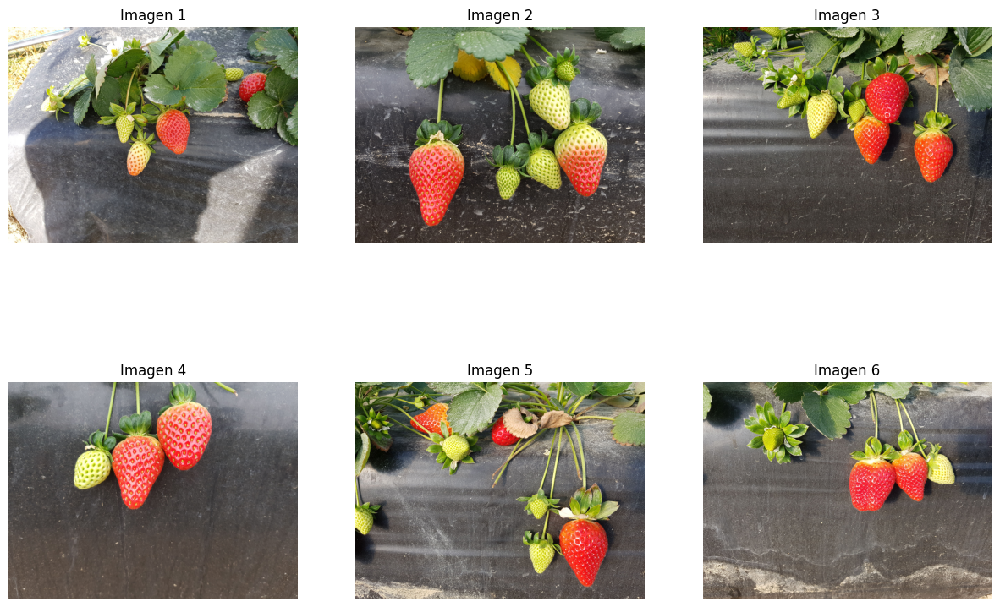

In [14]:
# Mostremos las imágenes
fig, axs = plt.subplots(2, 3, figsize=(15, 10))

axs[0, 0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0, 0].set_title('Imagen 1')
axs[0, 0].axis('off')
axs[0, 1].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[0, 1].set_title('Imagen 2')
axs[0, 1].axis('off')
axs[0, 2].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[0, 2].set_title('Imagen 3')
axs[0, 2].axis('off')
axs[1, 0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[1, 0].set_title('Imagen 4')
axs[1, 0].axis('off')
axs[1, 1].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[1, 1].set_title('Imagen 5')
axs[1, 1].axis('off')
axs[1, 2].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[1, 2].set_title('Imagen 6')
axs[1, 2].axis('off')

In [15]:
# Segmentamos las fresas
img_segmentada1 = segmentar_fresas(img1)
img_segmentada2 = segmentar_fresas(img2)
img_segmentada3 = segmentar_fresas(img3)
img_segmentada4 = segmentar_fresas(img4)
img_segmentada5 = segmentar_fresas(img5)
img_segmentada6 = segmentar_fresas(img6)


(-0.5, 1007.5, 755.5, -0.5)

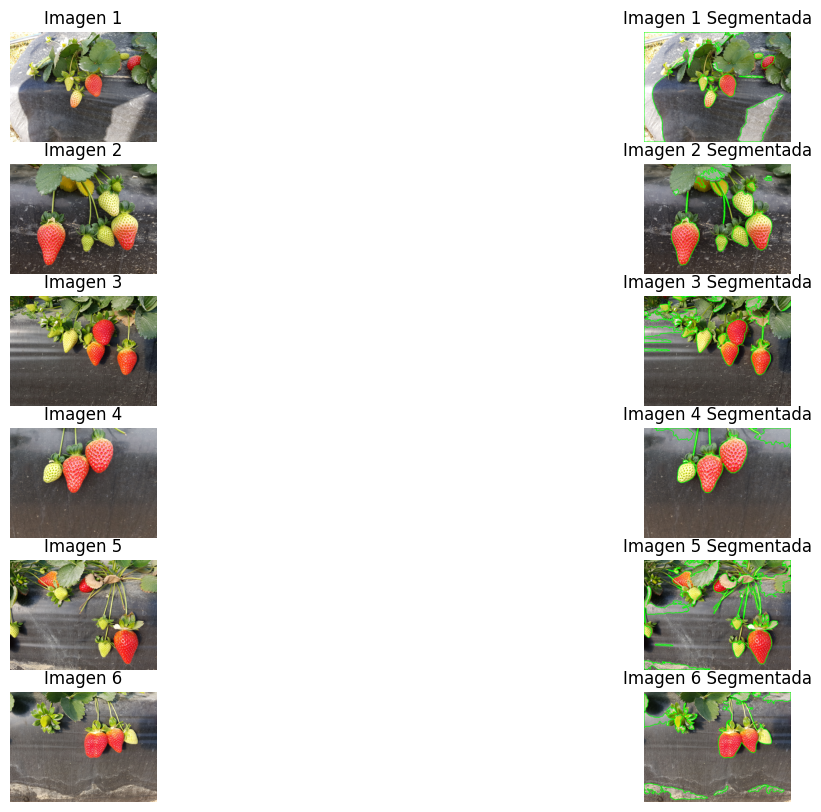

In [17]:
# Mostramos las imágenes segmentadas con su imagen original
# Mostrar las imágenes
fig, axs = plt.subplots(6, 2, figsize=(15, 10))

axs[0, 0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0, 0].set_title('Imagen 1')
axs[0, 0].axis('off')
axs[0, 1].imshow(cv2.cvtColor(img_segmentada1, cv2.COLOR_BGR2RGB))
axs[0, 1].set_title('Imagen 1 Segmentada')
axs[0, 1].axis('off')

axs[1, 0].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[1, 0].set_title('Imagen 2')
axs[1, 0].axis('off')
axs[1, 1].imshow(cv2.cvtColor(img_segmentada2, cv2.COLOR_BGR2RGB))
axs[1, 1].set_title('Imagen 2 Segmentada')
axs[1, 1].axis('off')

axs[2, 0].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[2, 0].set_title('Imagen 3')
axs[2, 0].axis('off')
axs[2, 1].imshow(cv2.cvtColor(img_segmentada3, cv2.COLOR_BGR2RGB))
axs[2, 1].set_title('Imagen 3 Segmentada')
axs[2, 1].axis('off')

axs[3, 0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[3, 0].set_title('Imagen 4')
axs[3, 0].axis('off')
axs[3, 1].imshow(cv2.cvtColor(img_segmentada4, cv2.COLOR_BGR2RGB))
axs[3, 1].set_title('Imagen 4 Segmentada')
axs[3, 1].axis('off')

axs[4, 0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[4, 0].set_title('Imagen 5')
axs[4, 0].axis('off')
axs[4, 1].imshow(cv2.cvtColor(img_segmentada5, cv2.COLOR_BGR2RGB))
axs[4, 1].set_title('Imagen 5 Segmentada')
axs[4, 1].axis('off')

axs[5, 0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[5, 0].set_title('Imagen 6')
axs[5, 0].axis('off')
axs[5, 1].imshow(cv2.cvtColor(img_segmentada6, cv2.COLOR_BGR2RGB))
axs[5, 1].set_title('Imagen 6 Segmentada')
axs[5, 1].axis('off')

Notemos que la segmentación no es perfecta, pero es un buen punto de partida para seguir trabajando. Por ejemplo, en la imagen 6 podemos notar como el contorno generado es demasiado grande y toma parte que no es de la fresa, pues toma parte del fondo. Centremonos en esta imagen en especifico para intentar mejorar la segmentación. 

Veamos esta imagen y su canal R

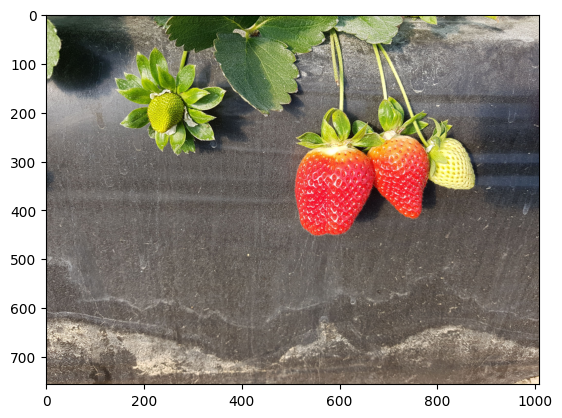

In [18]:
plt.imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))

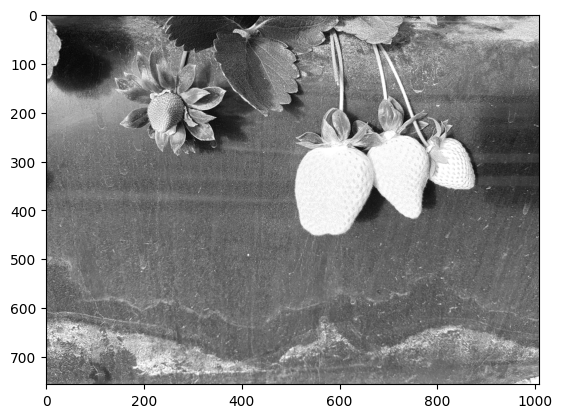

In [19]:
canal_r_img6 = img6[:,:,2]

plt.imshow(canal_r_img6, cmap='gray')

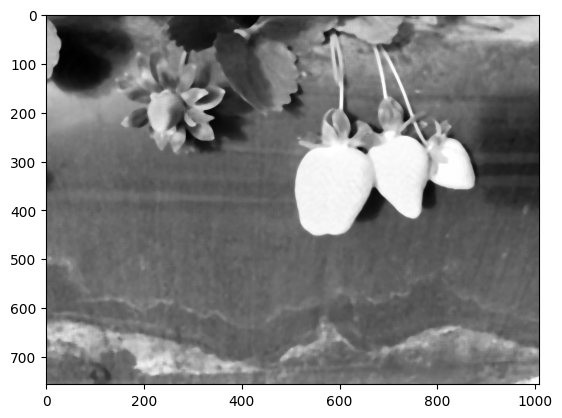

In [20]:
cr_median_img6 = cv2.medianBlur(canal_r_img6, 9)

plt.imshow(cr_median_img6, cmap='gray')

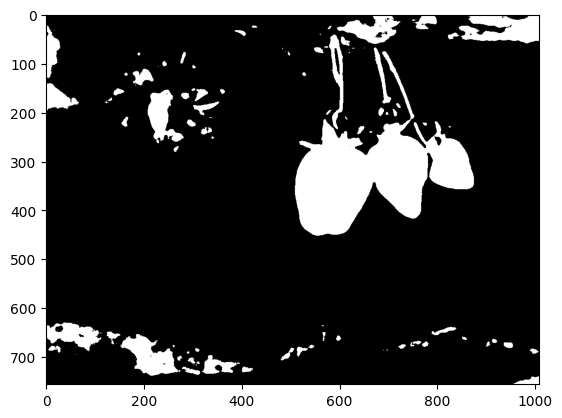

In [21]:
img_bin_img6 = cv2.threshold(cr_median_img6, 175, 255, cv2.THRESH_BINARY)[1]

plt.imshow(img_bin_img6, cmap='gray')


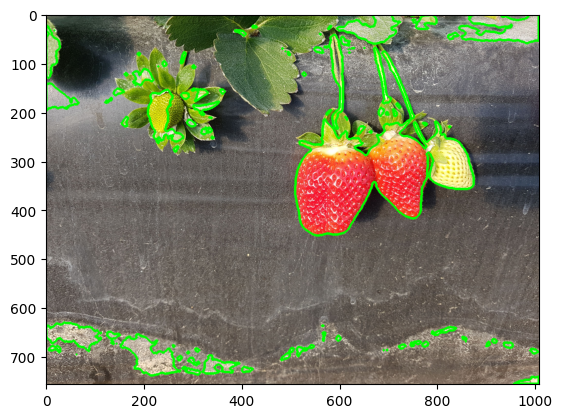

In [23]:
# Encontramos los contornos
contours_img6, _ = cv2.findContours(img_bin_img6, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Creamos una copia de la imagen
img_copy_img6 = img6.copy()

# Dibujamos los contornos
img_contornos_img6 = cv2.drawContours(img_copy_img6, contours_img6, -1, (0, 255, 0), 3)

plt.imshow(cv2.cvtColor(img_contornos_img6, cv2.COLOR_BGR2RGB))

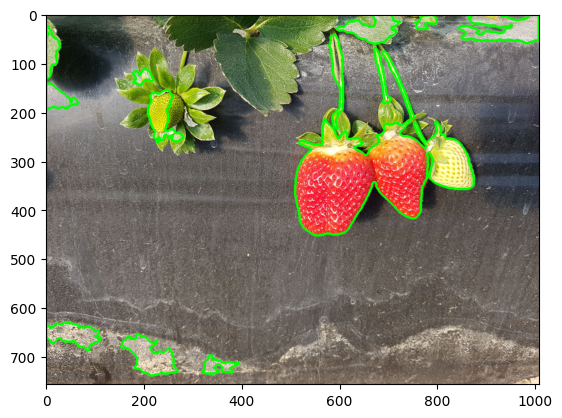

In [24]:
# Inicializa una lista para almacenar las fresas detectadas
fresas_img6 = []

# Creamos una copia de la imagen
imgaux2_img6 = img6.copy()

# Filtrar contornos
for cnt in contours_img6:
    area = cv2.contourArea(cnt)

    # Filtrar por área
    if area > 700:  # ajustar según la escala de la imagen
        fresas_img6.append(cnt)
        
# Dibujamos los contornos
img_contornos_2_img6 = cv2.drawContours(imgaux2_img6, fresas_img6, -1, (0, 255, 0), 3)

plt.imshow(cv2.cvtColor(img_contornos_2_img6, cv2.COLOR_BGR2RGB))

Hemos mejorado la segmentación de la fresa. Ahora, condensamos todo el proceso en una función.

In [25]:
def segmentar_fresas2(img):
    
    # Obtenemos el canal R
    canal_r = img[:,:,2]
    
    # Aplicamos un filtro de mediana
    cr_median = cv2.medianBlur(canal_r, 9)
    
    # Aplicamos un threshold
    img_bin = cv2.threshold(cr_median, 175, 255, cv2.THRESH_BINARY)[1]
    
    # Encontramos los contornos
    contours, _ = cv2.findContours(img_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Inicializa una lista para almacenar las fresas detectadas
    fresas = []
    
    # Filtrar contornos
    for cnt in contours:
        area = cv2.contourArea(cnt)
        
        # Filtrar por área
        if area > 700:  # ajustar según la escala de la imagen
            fresas.append(cnt)
    
    # Creamos una copia de la imagen
    img_copy = img.copy()
    
    # Dibujamos los contornos
    img_contornos = cv2.drawContours(img_copy, fresas, -1, (0, 255, 0), 3)
    
    return img_contornos

In [26]:
# Probamos la función
img1 = cv2.imread('Dataset/test/8.png')
img2 = cv2.imread('Dataset/test/373.png')
img3 = cv2.imread('Dataset/test/569.png')
img4 = cv2.imread('Dataset/test/802.png')
img5 = cv2.imread('Dataset/test/1251.png')
img6 = cv2.imread('Dataset/test/1405.png')


In [27]:
# Segmentamos las fresas
img_segmentada1 = segmentar_fresas2(img1)
img_segmentada2 = segmentar_fresas2(img2)
img_segmentada3 = segmentar_fresas2(img3)
img_segmentada4 = segmentar_fresas2(img4)
img_segmentada5 = segmentar_fresas2(img5)
img_segmentada6 = segmentar_fresas2(img6)


(-0.5, 1007.5, 755.5, -0.5)

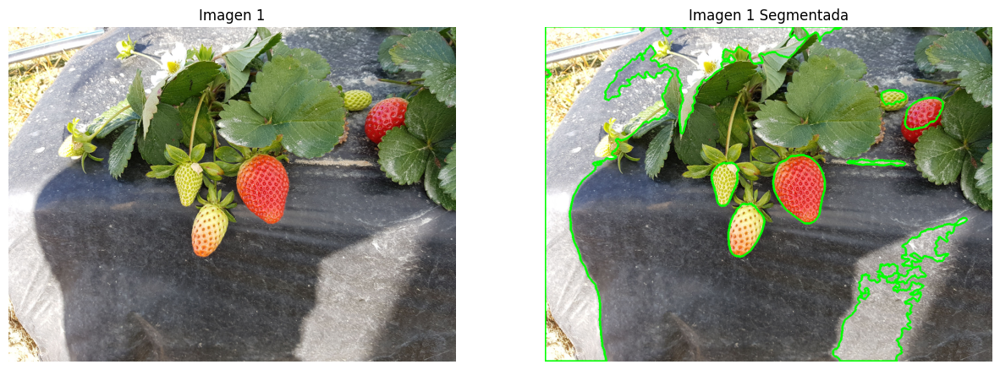

In [28]:
# Mostramos las imágenes segmentadas con su imagen original, imagen por imagen
# Para la imagen 1
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 1')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada1, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 1 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

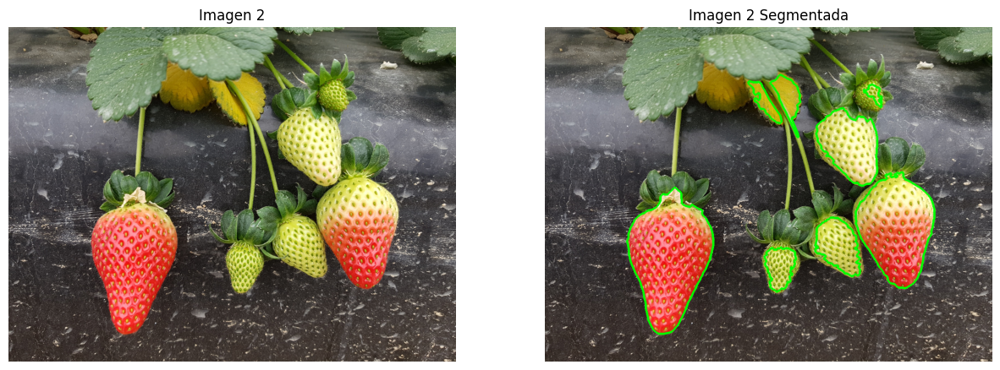

In [29]:
# Para la imagen 2
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 2')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada2, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 2 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

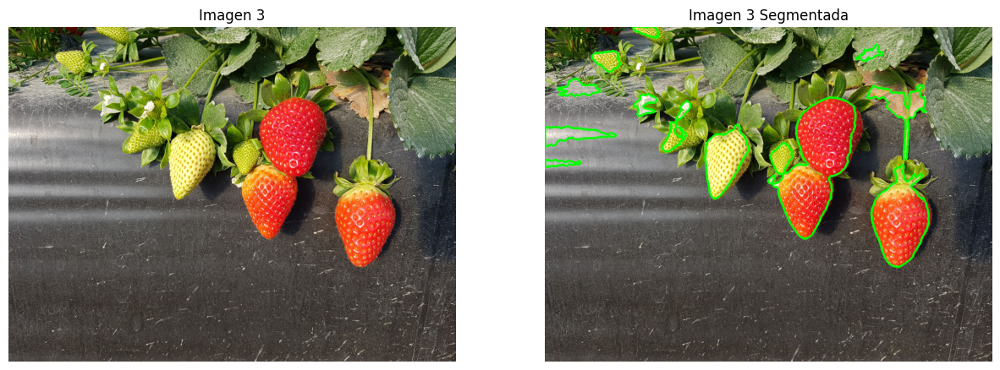

In [30]:
# Para la imagen 3
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 3')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada3, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 3 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

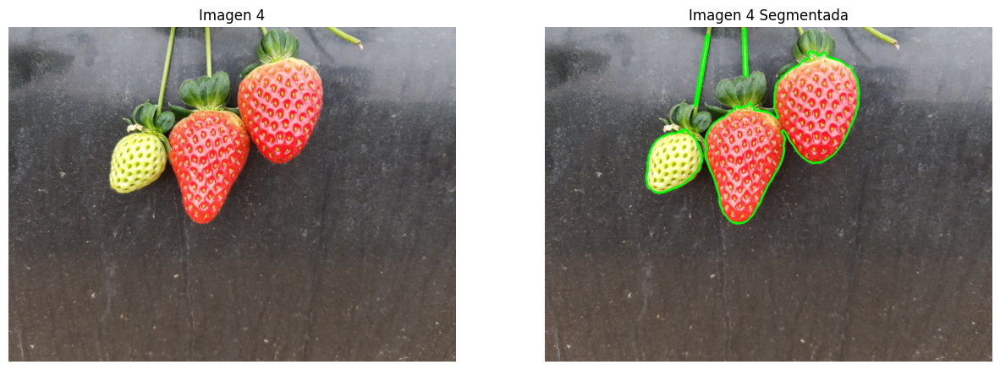

In [31]:
# Para la imagen 4
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 4')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada4, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 4 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

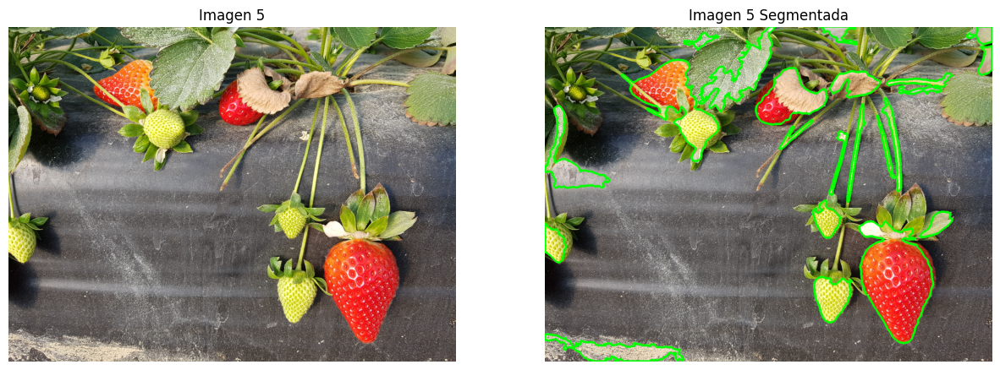

In [32]:
# Para la imagen 5
fig, axs = plt.subplots(1, 2, figsize=(15, 10))
    
axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada5, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 5 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

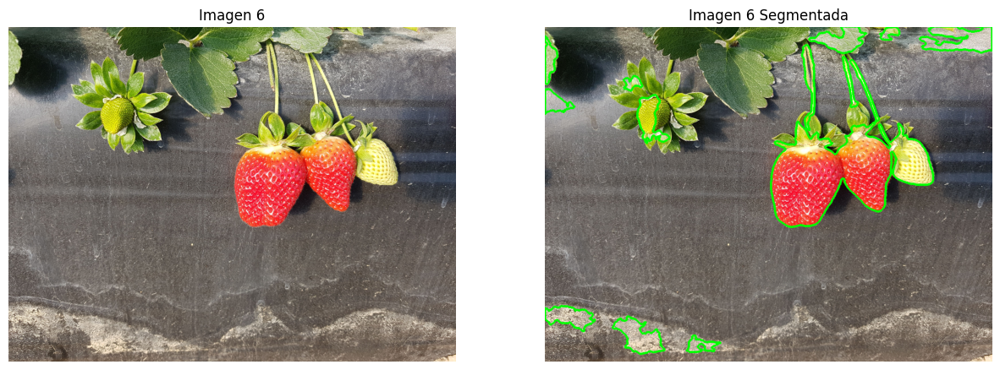

In [33]:
# Para la imagen 6
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 6')
axs[0].axis('off')

axs[1].imshow(cv2.cvtColor(img_segmentada6, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 6 Segmentada')
axs[1].axis('off')


La imagen 5 aún nos esta generando un poco de problemas, intentemos algo final, cambiando nuevamente el threshold.

In [34]:
def segmentar_fresas3(img):
    
    # Obtenemos el canal R
    canal_r = img[:,:,2]
    
    # Aplicamos un filtro de mediana
    cr_median = cv2.medianBlur(canal_r, 9)
    
    # Aplicamos un threshold
    img_bin = cv2.threshold(cr_median, 200, 255, cv2.THRESH_BINARY)[1]
    
    # Encontramos los contornos
    contours, _ = cv2.findContours(img_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Inicializa una lista para almacenar las fresas detectadas
    fresas = []
    
    # Filtrar contornos
    for cnt in contours:
        area = cv2.contourArea(cnt)
        
        # Filtrar por área
        if area > 700:  # ajustar según la escala de la imagen
            fresas.append(cnt)
    
    # Creamos una copia de la imagen
    img_copy = img.copy()
    
    # Dibujamos los contornos
    img_contornos = cv2.drawContours(img_copy, fresas, -1, (0, 255, 0), 3)
    
    return img_contornos

In [35]:
# Probamos la función con la imagen 5
img5 = cv2.imread('Dataset/test/1251.png')
img_segmentada5_aux = segmentar_fresas3(img5)


(-0.5, 1007.5, 755.5, -0.5)

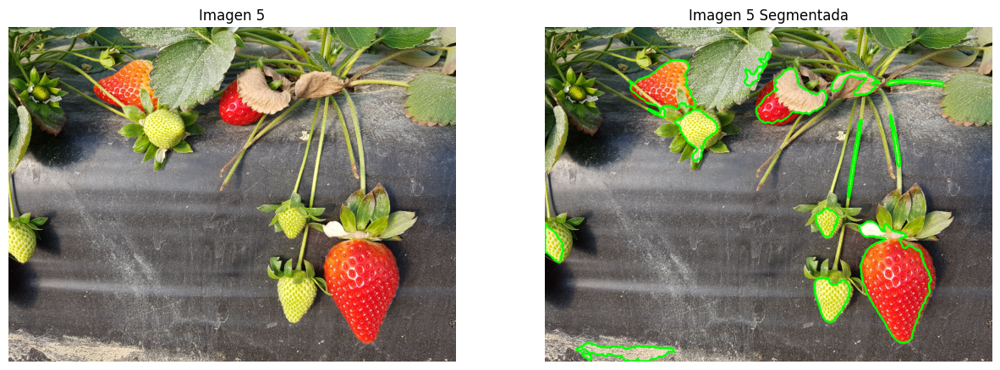

In [36]:
# Mostramos la imagen segmentada
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada5_aux, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 5 Segmentada')
axs[1].axis('off')

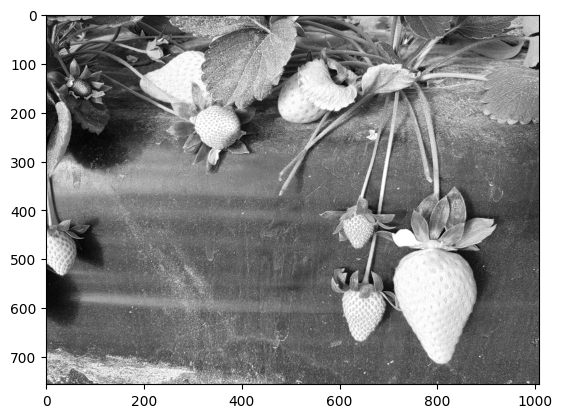

In [37]:
# Miremos el canal R de la imagen 5
canal_r_img5 = img5[:,:,2]

plt.imshow(canal_r_img5, cmap='gray')

Vamos a intentar usar una corrección gamma para mejorar la segmentación.


In [38]:
def gamma_correction(img, a, gamma):

    #Crear copia de la imagen tipo flotante dada la normalización
    img_copy = img.copy().astype(np.float32)/255.0
    #La función corrección gamma es de la forma ax^gamma, donde x es la imagen de entrada
    res_gamma = cv2.pow(img_copy,gamma)
    res = cv2.multiply(res_gamma, a)

    #Asegurar que la los datos queden entre 0 y 255 y sean uint8
    res[res<0] = 0
    res = res*255.0
    res[res>255] = 255

    res = res.astype(np.uint8)

    return res

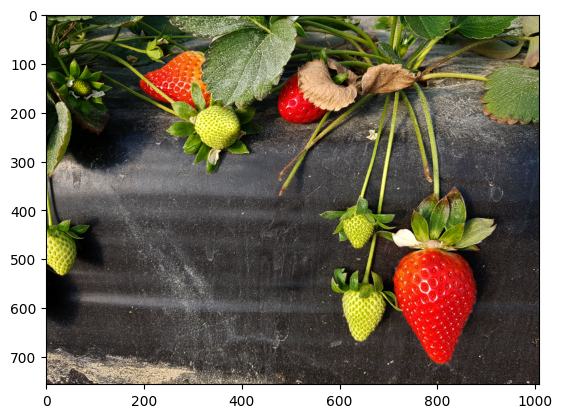

In [39]:
# Probamos la corrección gamma
img5_gamma = gamma_correction(img5, 1, 1.5)

plt.imshow(cv2.cvtColor(img5_gamma, cv2.COLOR_BGR2RGB))

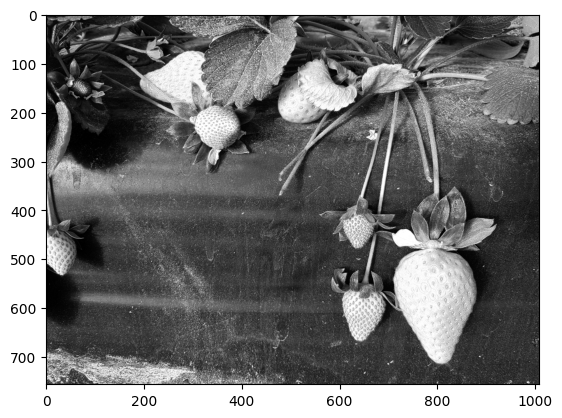

In [40]:
# Canal R de la imagen corregida
canal_r_img5_gamma = img5_gamma[:,:,2]

plt.imshow(canal_r_img5_gamma, cmap='gray')

(-0.5, 1007.5, 755.5, -0.5)

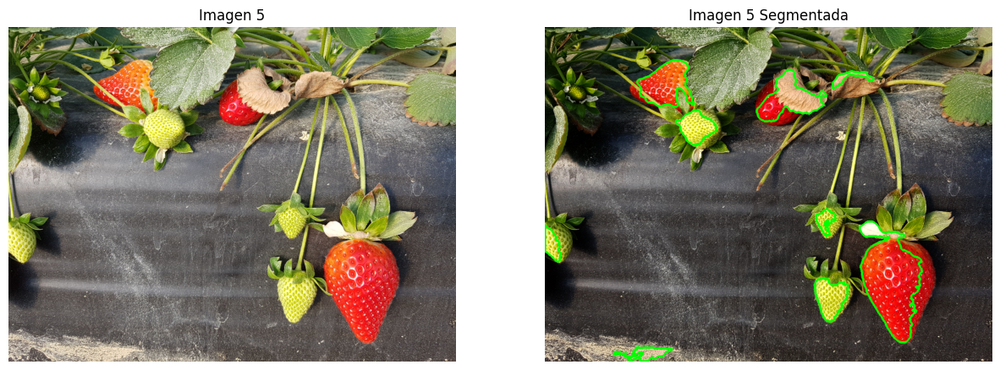

In [41]:

# Aplicamos la función de segmentación
img_seg5 = segmentar_fresas3(img5_gamma)

# Mostramos la imagen segmentada
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_seg5, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 5 Segmentada')
axs[1].axis('off')

Como vemos, temas como los de la iamgen 5, en donde una hoja marchita puede llegar a interferir en nuestras fresas, pero es un caso muy especial, por lo que no nos preocuparemos por el momento.

Así, nos quedamos con la función segmentar_fresas3 para segmentar las fresas en las imágenes. Apliquemos esta función a las imagenes cargadas

In [42]:
# Imagen 1
img1 = cv2.imread('Dataset/test/8.png')
img_segmentada1_final = segmentar_fresas3(img1)

# Imagen 2
img2 = cv2.imread('Dataset/test/373.png')
img_segmentada2_final = segmentar_fresas3(img2)

# Imagen 3
img3 = cv2.imread('Dataset/test/569.png')
img_segmentada3_final = segmentar_fresas3(img3)

# Imagen 4
img4 = cv2.imread('Dataset/test/802.png')
img_segmentada4_final = segmentar_fresas3(img4)

# Imagen 5
img5 = cv2.imread('Dataset/test/1251.png')
img_segmentada5_final = segmentar_fresas3(img5)

# Imagen 6
img6 = cv2.imread('Dataset/test/1405.png')
img_segmentada6_final = segmentar_fresas3(img6)

(-0.5, 1007.5, 755.5, -0.5)

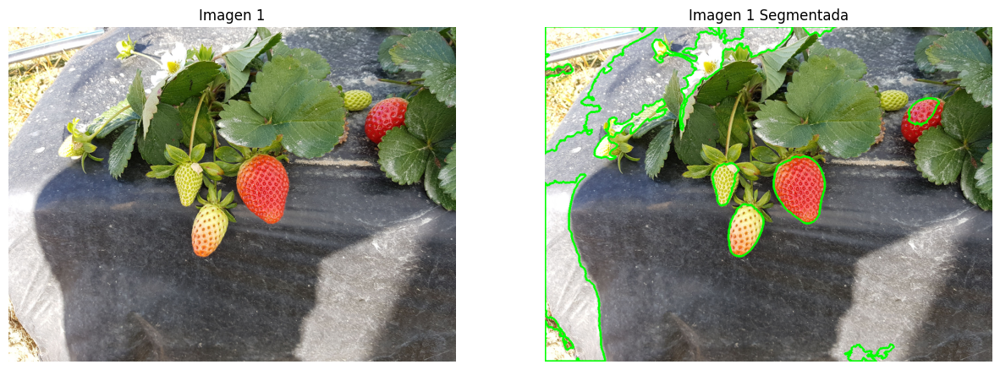

In [43]:
# Mostramos las imágenes segmentadas con su imagen original, imagen por imagen

# Para la imagen 1
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 1')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada1_final, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 1 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

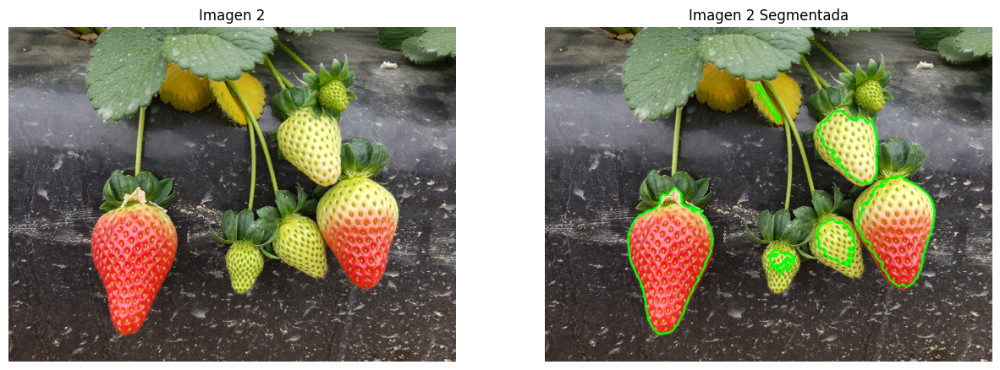

In [44]:
# Para la imagen 2
fig, axs = plt.subplots(1, 2, figsize=(15, 10))
    
axs[0].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 2')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada2_final, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 2 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

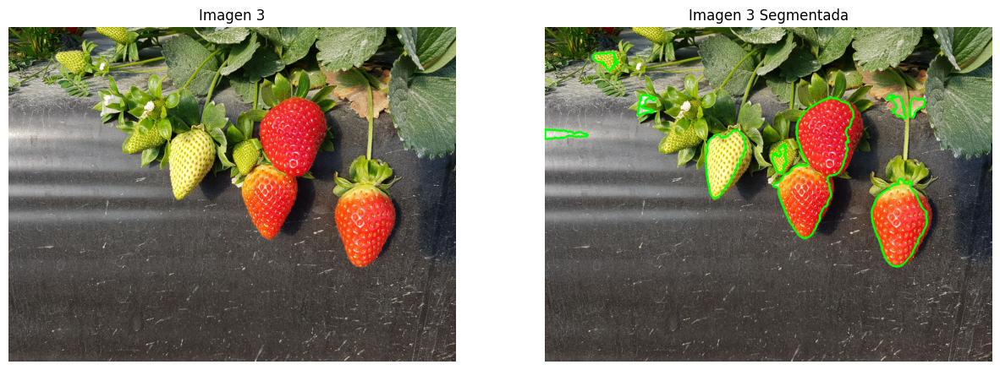

In [45]:
# Para la imagen 3
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 3')
axs[0].axis('off')

axs[1].imshow(cv2.cvtColor(img_segmentada3_final, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 3 Segmentada')
axs[1].axis('off')


(-0.5, 1007.5, 755.5, -0.5)

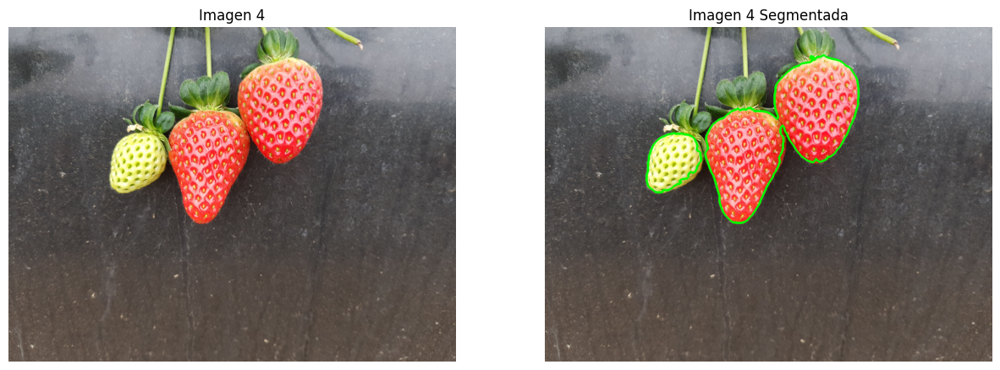

In [46]:
# Para la imagen 4
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 4')
axs[0].axis('off')

axs[1].imshow(cv2.cvtColor(img_segmentada4_final, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 4 Segmentada')
axs[1].axis('off')


(-0.5, 1007.5, 755.5, -0.5)

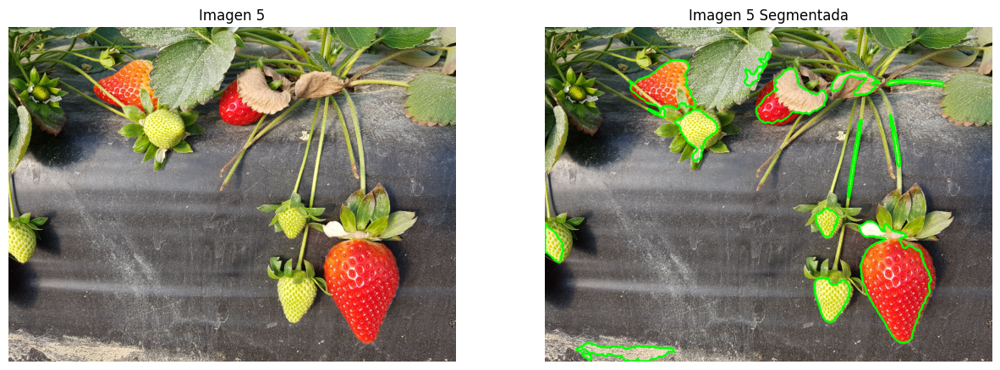

In [47]:
# Para la imagen 5
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')

axs[1].imshow(cv2.cvtColor(img_segmentada5_final, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 5 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

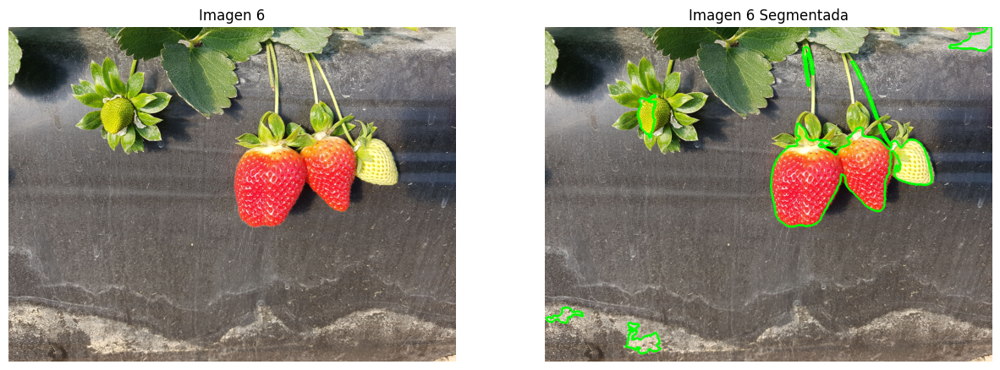

In [48]:
# Para la imagen 6
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 6')
axs[0].axis('off')

axs[1].imshow(cv2.cvtColor(img_segmentada6_final, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 6 Segmentada')
axs[1].axis('off')

Analicemos la imagen 6 en torno a su canal R y su posterior trehshold.

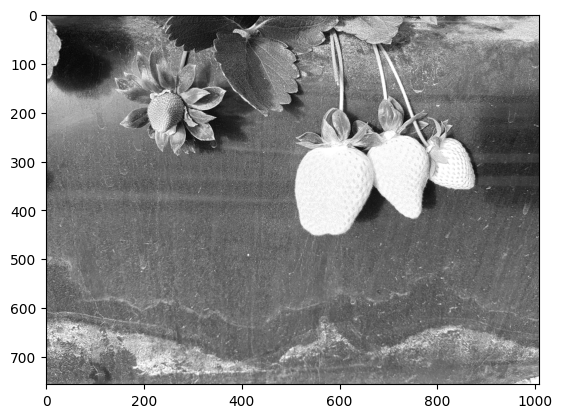

In [49]:
# Canal R de la imagen 6
canal_r_img6 = img6[:,:,2]

plt.imshow(canal_r_img6, cmap='gray')


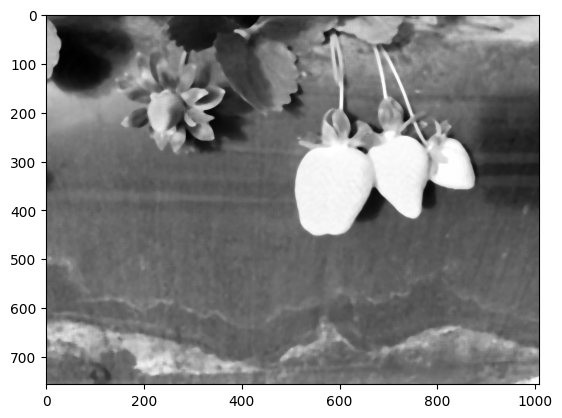

In [50]:
# Aplicamos un filtro de mediana
cr_median_img6 = cv2.medianBlur(canal_r_img6, 9)

plt.imshow(cr_median_img6, cmap='gray')

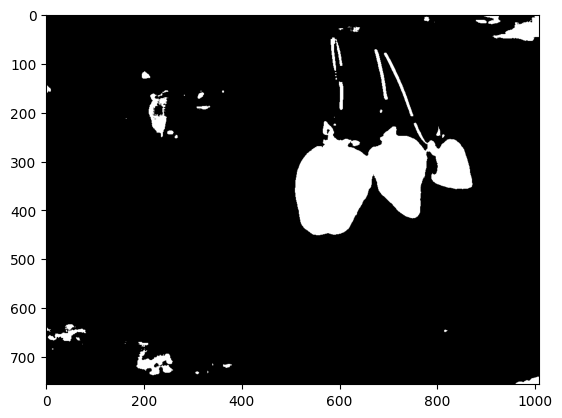

In [51]:
# Aplicamos un threshold
img_bin_img6 = cv2.threshold(cr_median_img6, 205, 255, cv2.THRESH_BINARY)[1]

plt.imshow(img_bin_img6, cmap='gray')

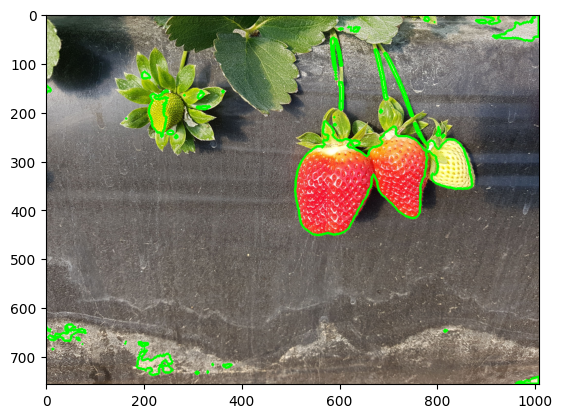

In [52]:
# Encontramos los contornos
contours_img6, _ = cv2.findContours(img_bin_img6, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Creamos una copia de la imagen
img_copy_img6 = img6.copy()

# Dibujamos los contornos
img_contornos_img6 = cv2.drawContours(img_copy_img6, contours_img6, -1, (0, 255, 0), 3)

plt.imshow(cv2.cvtColor(img_contornos_img6, cv2.COLOR_BGR2RGB))

Podemos ver que subiendo 5 puntos el threshold, logramos mejorar la segmentación de la imagen 6. Actualicemos la función y veamos los resultados.

In [53]:
def segmentar_fresas4(img):
    
    # Obtenemos el canal R
    canal_r = img[:,:,2]
    
    # Aplicamos un filtro de mediana
    cr_median = cv2.medianBlur(canal_r, 9)
    
    # Aplicamos un threshold
    img_bin = cv2.threshold(cr_median, 205, 255, cv2.THRESH_BINARY)[1]
    
    # Encontramos los contornos
    contours, _ = cv2.findContours(img_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Inicializa una lista para almacenar las fresas detectadas
    fresas = []
    
    # Filtrar contornos
    for cnt in contours:
        area = cv2.contourArea(cnt)
        
        # Filtrar por área
        if area > 700:  # ajustar según la escala de la imagen
            fresas.append(cnt)
    
    # Creamos una copia de la imagen
    img_copy = img.copy()
    
    # Dibujamos los contornos
    img_contornos = cv2.drawContours(img_copy, fresas, -1, (0, 255, 0), 3)
    
    return img_contornos, fresas

In [54]:
# Probamos la función con la imagen 1  
img_segmentada1_final_1, fresas1 = segmentar_fresas4(img1)

# Probamos la función con la imagen 2
img_segmentada2_final_2, fresas2 = segmentar_fresas4(img2)

# Probamos la función con la imagen 3
img_segmentada3_final_3, fresas3 = segmentar_fresas4(img3)

# Probamos la función con la imagen 4
img_segmentada4_final_4, fresas4 = segmentar_fresas4(img4)

# Probamos la función con la imagen 5
img_segmentada5_final_5, fresas5 = segmentar_fresas4(img5)

# Probamos la función con la imagen 6
img_segmentada6_final_6, fresas6 = segmentar_fresas4(img6)

(-0.5, 1007.5, 755.5, -0.5)

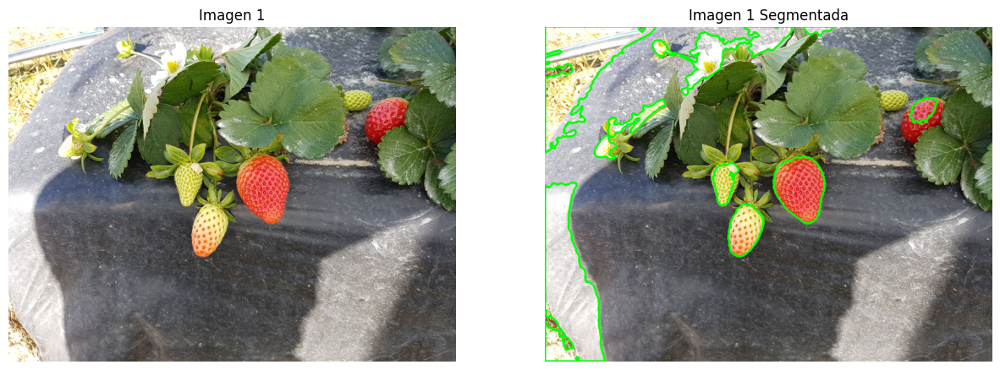

In [55]:
# Mostramos las imágenes segmentadas con su imagen original, imagen por imagen

# Para la imagen 1
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 1')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada1_final_1, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 1 Segmentada')
axs[1].axis('off')



(-0.5, 1007.5, 755.5, -0.5)

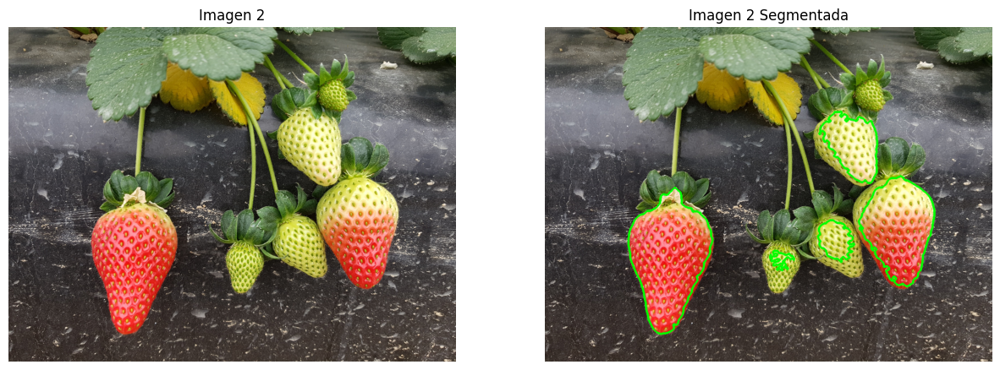

In [56]:
# Para la imagen 2
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 2')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada2_final_2, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 2 Segmentada')
axs[1].axis('off')


(-0.5, 1007.5, 755.5, -0.5)

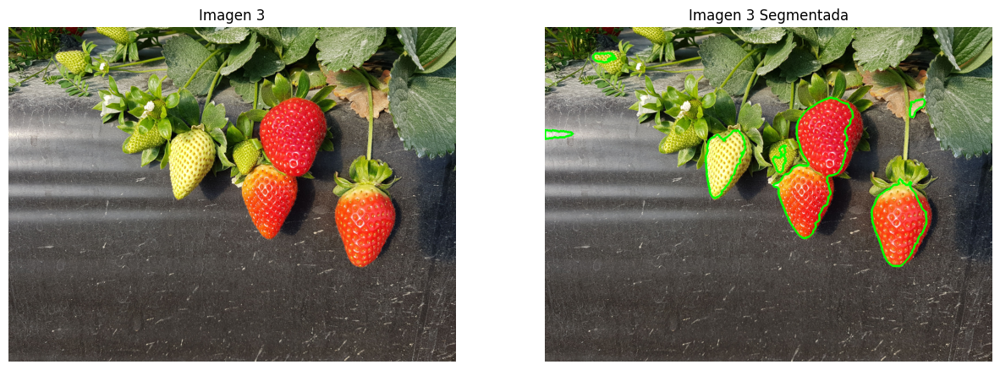

In [58]:
# Para la imagen 3
fig, axs = plt.subplots(1, 2, figsize=(15, 10))
    
axs[0].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 3')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada3_final_3, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 3 Segmentada')
axs[1].axis('off')


(-0.5, 1007.5, 755.5, -0.5)

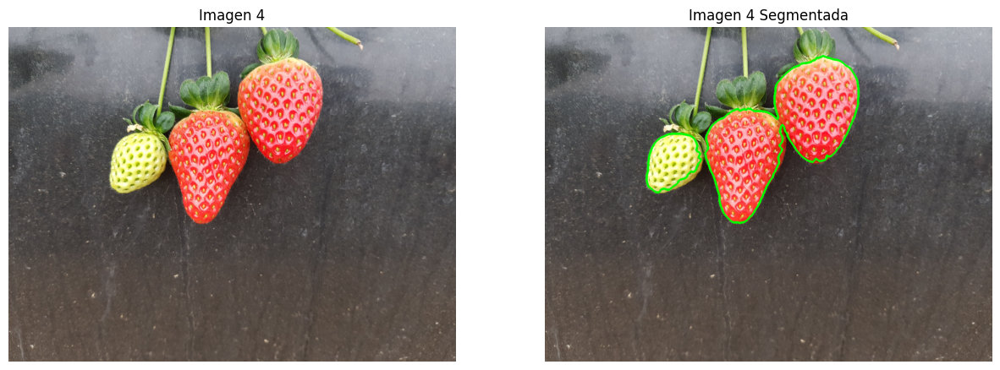

In [59]:
# Para la imagen 4
fig, axs = plt.subplots(1, 2, figsize=(15, 10))
    
axs[0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 4')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada4_final_4, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 4 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

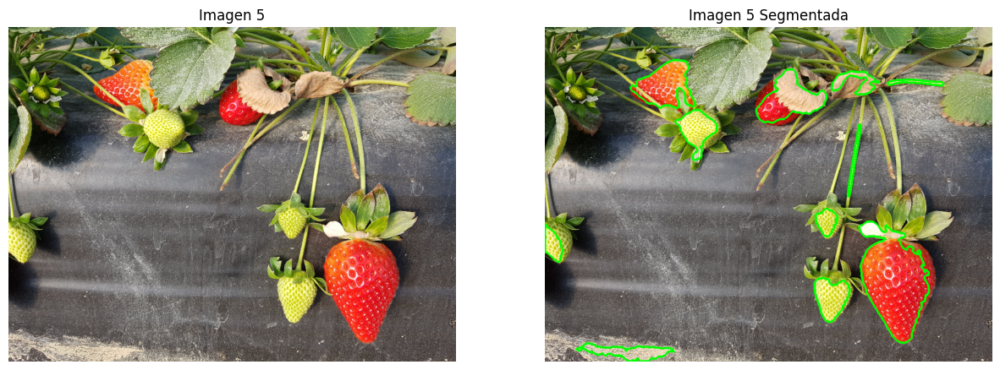

In [60]:
# Para la imagen 5
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada5_final_5, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 5 Segmentada')
axs[1].axis('off')


(-0.5, 1007.5, 755.5, -0.5)

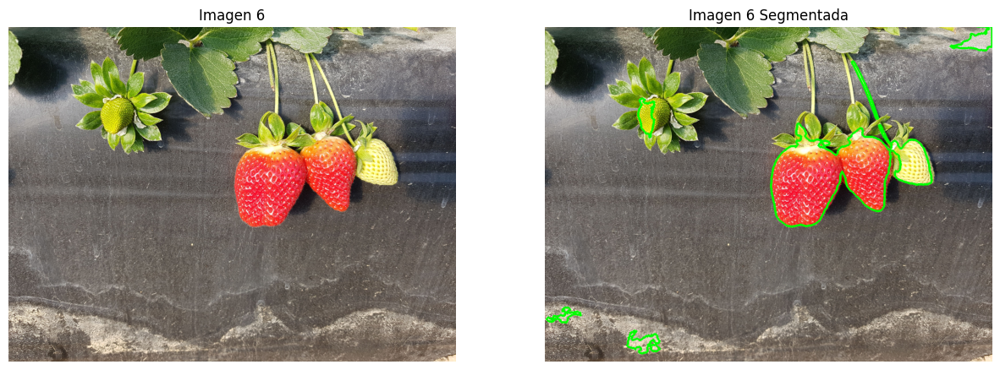

In [61]:
# Para la imagen 6
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 6')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img_segmentada6_final_6, cv2.COLOR_BGR2RGB))
axs[1].set_title('Imagen 6 Segmentada')
axs[1].axis('off')

Ahora, traemos la función que teníamos para el preprocesamiento de la parte roja

In [62]:
#Definir la función para aplicar la transformación sobre la imagen RGB
def apply_f_on_rgb(img, f, args):
    #Crear una matriz de ceros del tamaño de la imagen de entrada
    res = np.zeros(img.shape, np.uint8)
    #Aplicar la transformación f sobre cada canal del espacio de color RGB
    res[:,:,0] = f(img[:,:,0], *args)
    res[:,:,1] = f(img[:,:,1], *args)
    res[:,:,2] = f(img[:,:,2], *args)

    return res

In [63]:
def preprocesamiento(img):
    # Aplicar corrección de gamma
    img_gamma = apply_f_on_rgb(img, gamma_correction, [1, 1.5])
    
    # Aplicar filtro de mediana
    img_mediana = cv2.medianBlur(img_gamma, 15)
    
    # Aplicar el canal B del espacio LAB
    img_LAB = cv2.cvtColor(img_mediana, cv2.COLOR_BGR2LAB)
    img_B_LAB = img_LAB[:,:,2]
    
    # Aplicar la operación suma
    img_suma = cv2.add(img_B_LAB, 150)
    
    return img_suma

In [64]:
# Probamos la función con la imagen 1
img1_preprocesada_rojo = preprocesamiento(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))

# Probamos la función con la imagen 2
img2_preprocesada_rojo = preprocesamiento(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))

# Probamos la función con la imagen 3
img3_preprocesada_rojo = preprocesamiento(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))

# Probamos la función con la imagen 4
img4_preprocesada_rojo = preprocesamiento(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))

# Probamos la función con la imagen 5
img5_preprocesada_rojo = preprocesamiento(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))

# Probamos la función con la imagen 6
img6_preprocesada_rojo = preprocesamiento(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))

(-0.5, 1007.5, 755.5, -0.5)

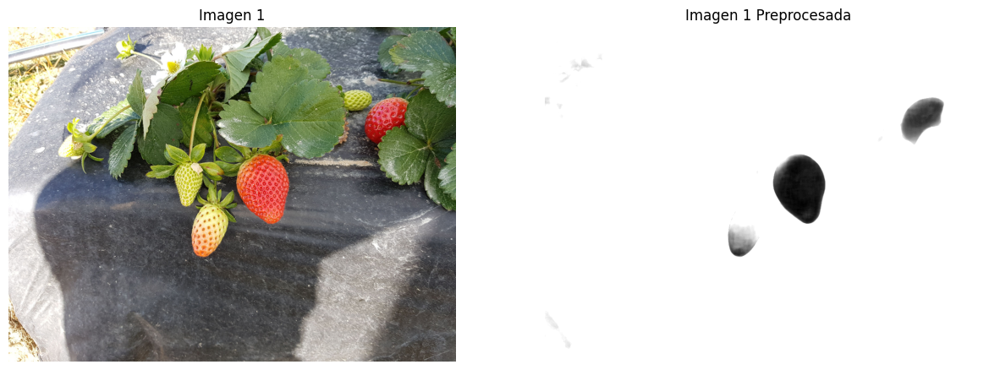

In [65]:
# Mostramos las imágenes preprocesadas con su imagen original, imagen por imagen

# Para la imagen 1
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 1')
axs[0].axis('off')
axs[1].imshow(img1_preprocesada_rojo, cmap='gray')
axs[1].set_title('Imagen 1 Preprocesada')
axs[1].axis('off')

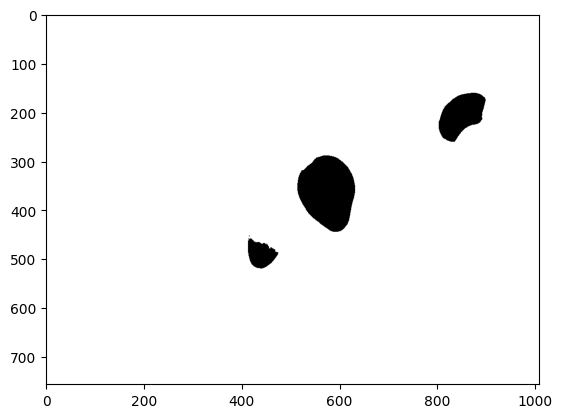

In [66]:
# Aplico un threshold a la imagen preprocesada
img1_bin = cv2.threshold(img1_preprocesada_rojo, 240, 255, cv2.THRESH_BINARY)[1]

plt.imshow(img1_bin, cmap='gray')

(-0.5, 1007.5, 755.5, -0.5)

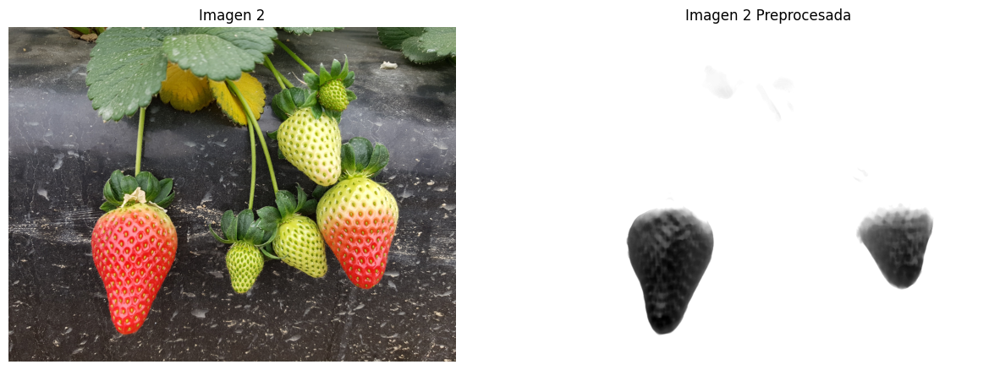

In [67]:
# Para la imagen 2
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 2')
axs[0].axis('off')
axs[1].imshow(img2_preprocesada_rojo, cmap='gray')
axs[1].set_title('Imagen 2 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

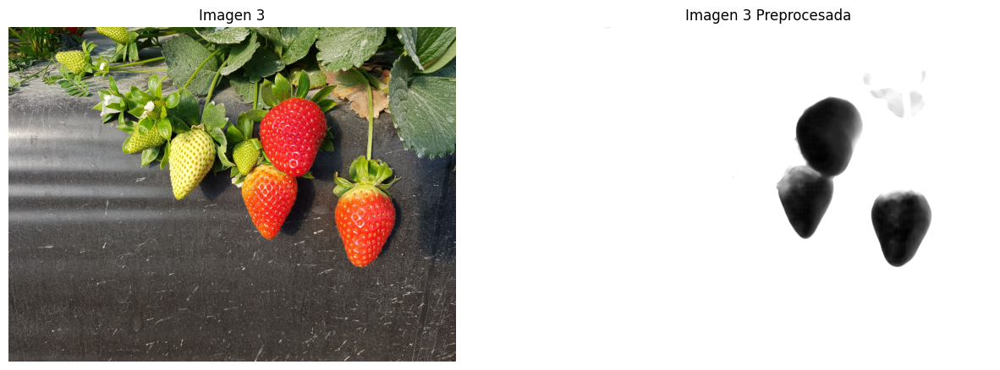

In [68]:
# Para la imagen 3
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 3')
axs[0].axis('off')
axs[1].imshow(img3_preprocesada_rojo, cmap='gray')
axs[1].set_title('Imagen 3 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

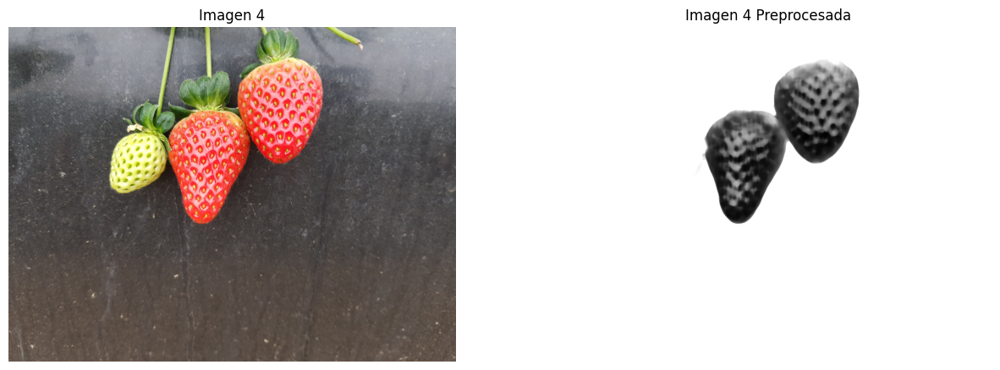

In [69]:
# Para la imagen 4
fig, axs = plt.subplots(1, 2, figsize=(15, 10))
    
axs[0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 4')
axs[0].axis('off')
axs[1].imshow(img4_preprocesada_rojo, cmap='gray')
axs[1].set_title('Imagen 4 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

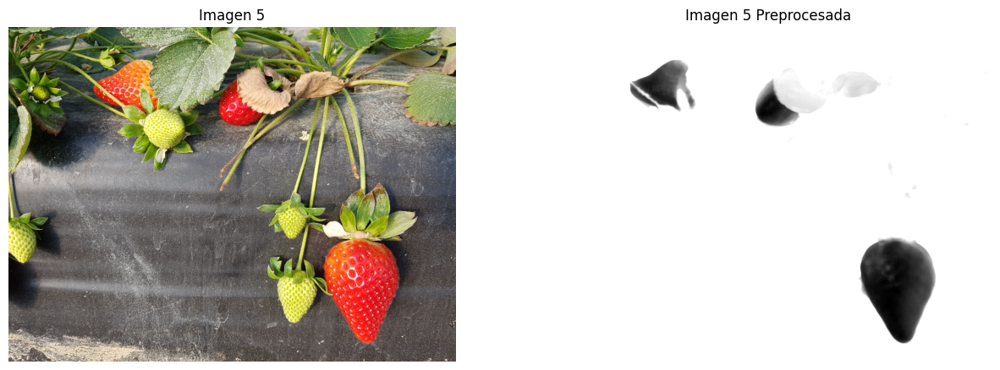

In [70]:
# Para la imagen 5
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')
axs[1].imshow(img5_preprocesada_rojo, cmap='gray')
axs[1].set_title('Imagen 5 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

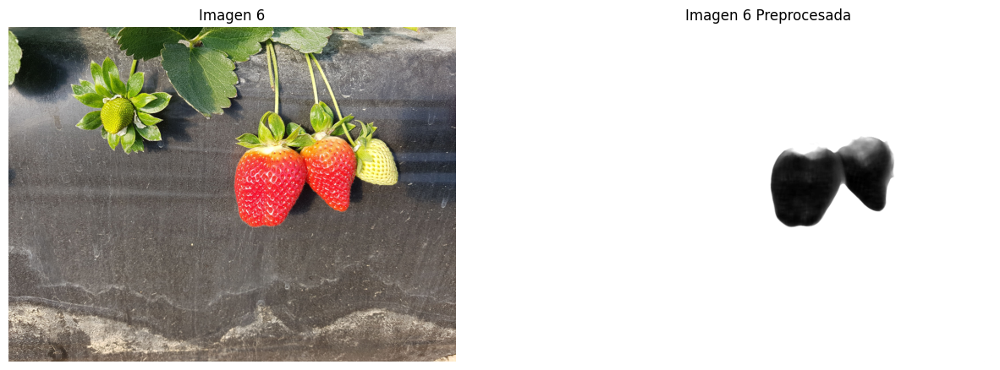

In [71]:
# Para la imagen 6
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 6')
axs[0].axis('off')
axs[1].imshow(img6_preprocesada_rojo, cmap='gray')
axs[1].set_title('Imagen 6 Preprocesada')
axs[1].axis('off')

Estudiemos entonces, con la imagen 1, tomar cada uno de los contornos que se tienen y compararlos con la imagen preprocesada específicamente para el rojo.

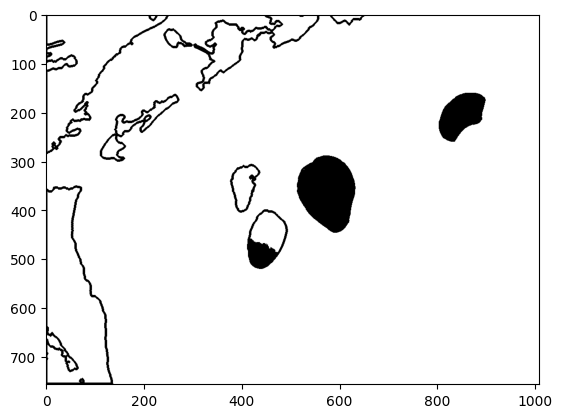

In [72]:
# Hagamos una copia de la imagen preprocesada 1
img1_bin_copy = img1_bin.copy()

# Dibujar los contornos de la imagen 1 sobre la imagen preprocesada
img1_contornos_prepro = cv2.drawContours(img1_bin_copy, fresas1, -1, (0, 255, 0), 3)

plt.imshow(img1_contornos_prepro, cmap='gray')

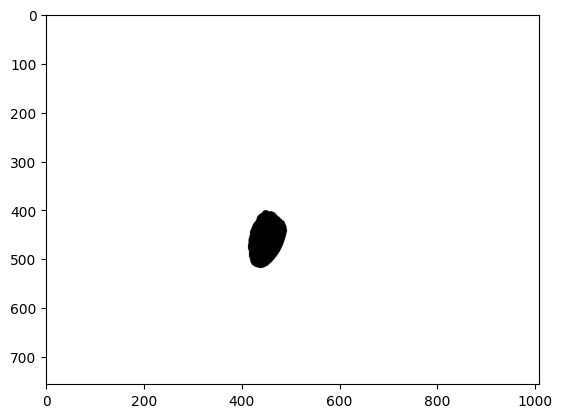

In [73]:
# La idea es tomar cada uno de los contornos. Dibujar este contorno en específico en la imagen binarizada y comparar el área del contorno general con el área de lo que es negro dentro de ese mismo contorno

# Lista para almacenar los contornos que cumplen con el criterio
contornos_filtrados = []

mask1 = np.zeros_like(img1_bin)

cv2.drawContours(mask1, [fresas1[0]], -1, 255, thickness=cv2.FILLED)

inv_mask1 = cv2.bitwise_not(mask1)

# Mostrar la mascara
plt.imshow(inv_mask1, cmap='gray')

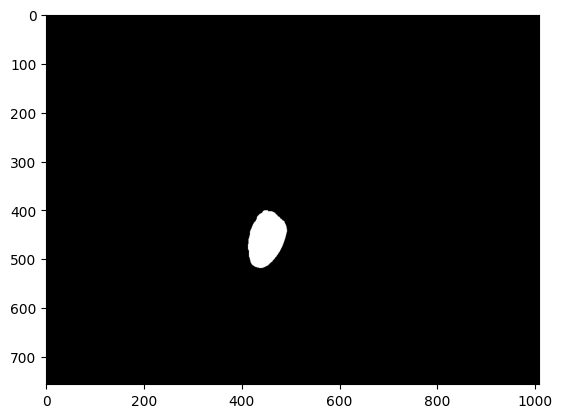

In [74]:
plt.imshow(mask1, cmap='gray')

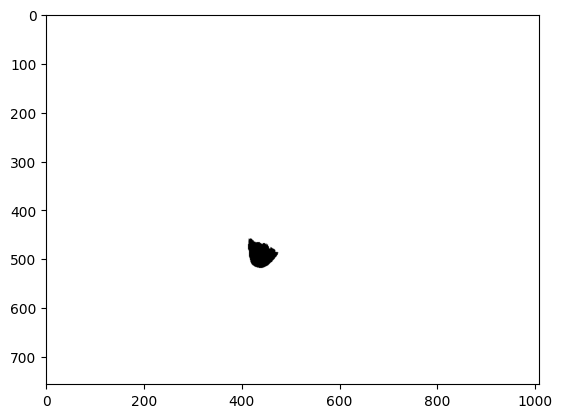

In [75]:
# Extraer los píxeles en la región del contorno
region_pixeada1 = cv2.bitwise_or(img1_bin, inv_mask1)

# Mostrar la region
plt.imshow(region_pixeada1, cmap='gray')

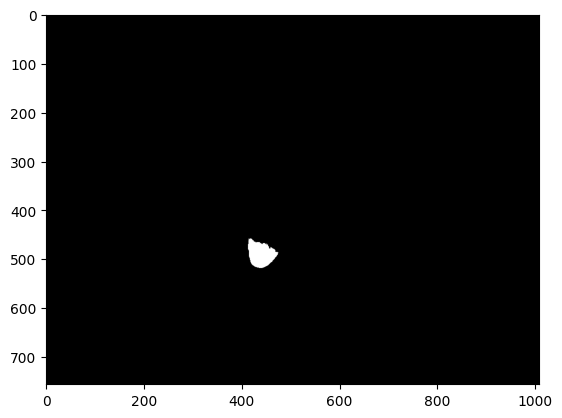

In [76]:
# Cuento la cantidad de pixeles negro de ambas mascaras

# Primero obtengo la inversa de la ultima mascara
inv_regpix1 = cv2.bitwise_not(region_pixeada1)

# Muestro la mascara
plt.imshow(inv_regpix1, cmap='gray')

In [77]:
# Ahora si, realizo la cuenta
pix_gen = cv2.countNonZero(mask1)
pix_roj = cv2.countNonZero(inv_regpix1)

# Calcular el porcentaje de píxeles negros
porcentaje_negro = (pix_roj / pix_gen) * 100 if pix_gen > 0 else 0

# Si el porcentaje de píxeles negros es mayor al 80%, añadir a la lista
if porcentaje_negro > 80:
    contornos_filtrados.append(fresas1[0])
    
print(contornos_filtrados)

[]


Al parecer, sirvió para el primer contorno, terminemos el recorrido por los filtros

In [78]:
for cont in fresas1:
    mask = np.zeros_like(img1_bin)

    cv2.drawContours(mask, [cont], -1, 255, thickness=cv2.FILLED)
    
    inv_mask = cv2.bitwise_not(mask)
    
    # Extraer los píxeles en la región del contorno
    region_pixeada = cv2.bitwise_or(img1_bin, inv_mask)
    
    # Primero obtengo la inversa de la ultima mascara
    inv_regpix = cv2.bitwise_not(region_pixeada)
    
    # Ahora si, realizo la cuenta
    pix_gen = cv2.countNonZero(mask)
    pix_roj = cv2.countNonZero(inv_regpix)
    
    # Calcular el porcentaje de píxeles negros
    porcentaje_negro = (pix_roj / pix_gen) * 100 if pix_gen > 0 else 0
    
    # Si el porcentaje de píxeles negros es mayor al 80%, añadir a la lista
    if porcentaje_negro > 80:
        contornos_filtrados.append(cont)
        

print(contornos_filtrados)
    

[array([[[581, 294]],

       [[580, 295]],

       [[579, 295]],

       [[578, 296]],

       [[571, 296]],

       [[570, 295]],

       [[566, 295]],

       [[565, 296]],

       [[563, 296]],

       [[559, 300]],

       [[557, 300]],

       [[556, 301]],

       [[555, 301]],

       [[554, 302]],

       [[553, 302]],

       [[552, 303]],

       [[549, 303]],

       [[548, 304]],

       [[545, 304]],

       [[544, 305]],

       [[543, 305]],

       [[542, 306]],

       [[540, 306]],

       [[539, 307]],

       [[538, 307]],

       [[536, 309]],

       [[535, 309]],

       [[534, 310]],

       [[533, 310]],

       [[531, 312]],

       [[530, 312]],

       [[528, 314]],

       [[527, 314]],

       [[524, 317]],

       [[524, 318]],

       [[523, 319]],

       [[523, 321]],

       [[522, 322]],

       [[522, 323]],

       [[521, 324]],

       [[521, 325]],

       [[520, 326]],

       [[520, 328]],

       [[519, 329]],

       [[519, 330]],

       [[

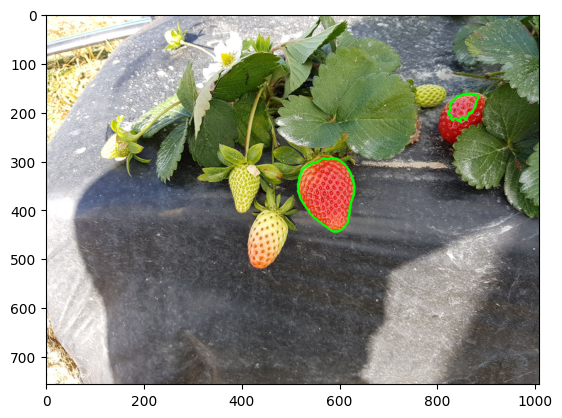

In [80]:
# Dibujamos los contornos obtenidos
# Hagamos una copia de la imagen preprocesada 1
img1_copy = img1.copy()

# Dibujar los contornos de la imagen 1 sobre la imagen preprocesada
img1_cont_final = cv2.drawContours(img1_copy, contornos_filtrados, -1, (0, 255, 0), 3)

plt.imshow(cv2.cvtColor(img1_cont_final, cv2.COLOR_BGR2RGB))

Como vemos, la segmentación resulta correcta. Resta entonces condensar todo en una función

In [84]:
def segmentacion_final(img, fresas):
    img_preprocesada = preprocesamiento(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    
    img_bin = cv2.threshold(img_preprocesada, 240, 255, cv2.THRESH_BINARY)[1]
    
    # Lista para almacenar los contornos que cumplen con el criterio
    cont_filtrados = []
    
    for cont in fresas:
        mask = np.zeros_like(img_bin)
    
        cv2.drawContours(mask, [cont], -1, 255, thickness=cv2.FILLED)
        
        inv_mask = cv2.bitwise_not(mask)
        
        # Extraer los píxeles en la región del contorno
        region_pixeada = cv2.bitwise_or(img_bin, inv_mask)
        
        # Primero obtengo la inversa de la ultima mascara
        inv_regpix = cv2.bitwise_not(region_pixeada)
        
        # Ahora si, realizo la cuenta
        pix_gen = cv2.countNonZero(mask)
        pix_roj = cv2.countNonZero(inv_regpix)
        
        # Calcular el porcentaje de píxeles negros
        porcentaje_negro = (pix_roj / pix_gen) * 100 if pix_gen > 0 else 0
        
        # Si el porcentaje de píxeles negros es mayor al 80%, añadir a la lista
        if porcentaje_negro > 80:
            cont_filtrados.append(cont)
            
    img_copy = img.copy()

    # Dibujar los contornos de la imagen 1 sobre la imagen preprocesada
    img_cont_final = cv2.drawContours(img_copy, cont_filtrados, -1, (0, 255, 0), 3)

    return img_cont_final

In [85]:
# Aplicar la función a la imagen 1
img1_final = segmentacion_final(img1, fresas1)

# Aplicar la función a la imagen 2
img2_final = segmentacion_final(img2, fresas2)

# Aplicar la función a la imagen 3
img3_final = segmentacion_final(img3, fresas3)

# Aplicar la función a la imagen 4
img4_final = segmentacion_final(img4, fresas4)

# Aplicar la función a la imagen 5
img5_final = segmentacion_final(img5, fresas5)

# Aplicar la función a la imagen 6
img6_final = segmentacion_final(img6, fresas6)

(-0.5, 1007.5, 755.5, -0.5)

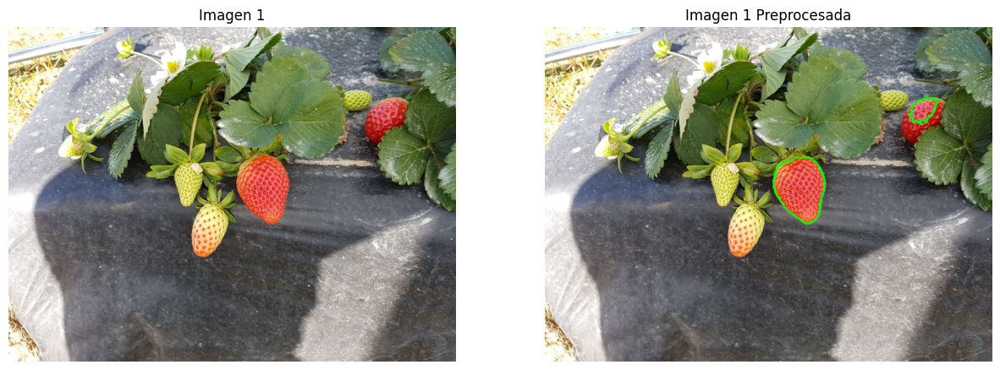

In [86]:
# Mostrar los resultados, imagen por imagen

# Para la imagen 1
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 1')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img1_final, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 1 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

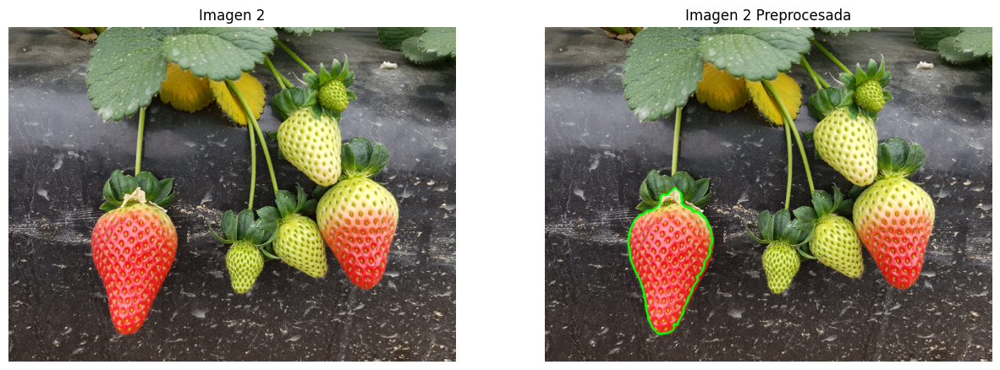

In [87]:
# Para la imagen 2
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 2')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img2_final, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 2 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

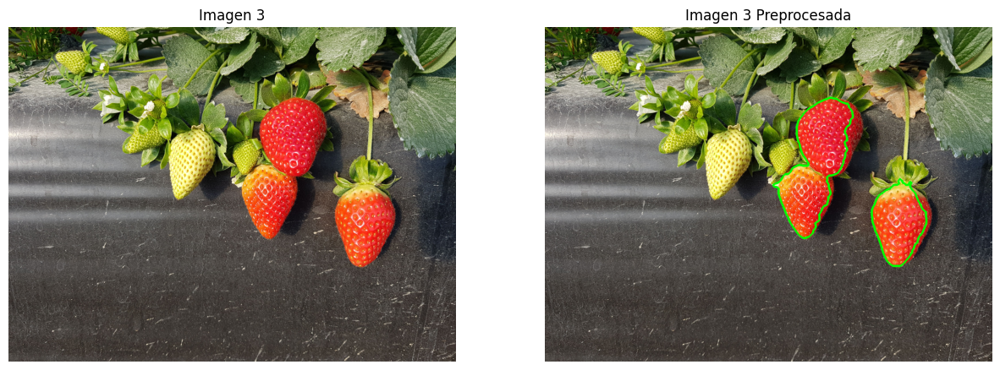

In [88]:
# Para la imagen 3
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 3')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img3_final, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 3 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

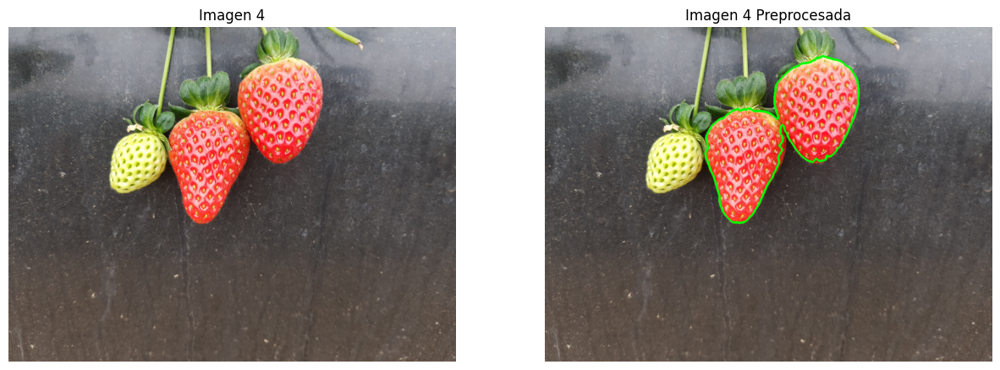

In [89]:
# Para la imagen 4
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 4')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img4_final, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 4 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

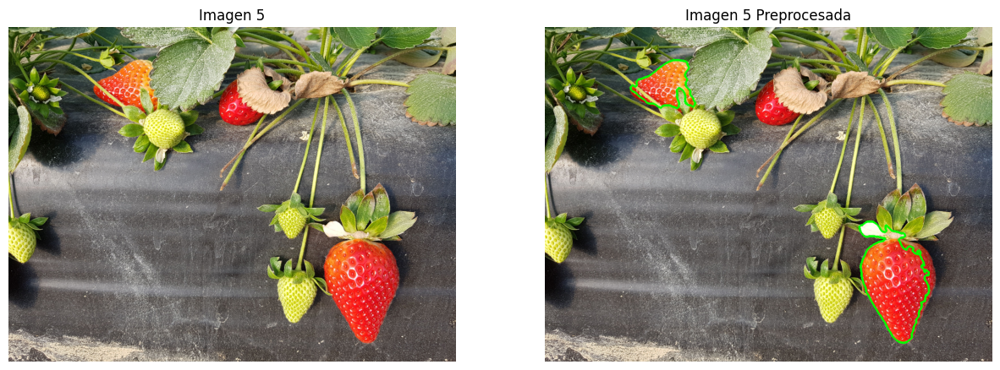

In [90]:
# Para la imagen 5
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img5_final, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 5 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

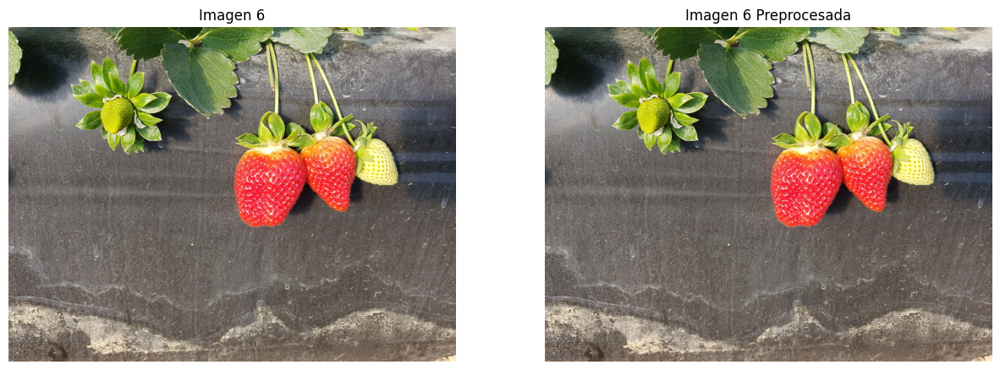

In [91]:
# Para la imagen 6
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 6')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img6_final, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 6 Preprocesada')
axs[1].axis('off')

Obtuvimos los resultados que deseabamos, excepto en la imagen 6, veamos que sucedió. Para esto, hagamos todo el proceso paso por paso para esta imagen.

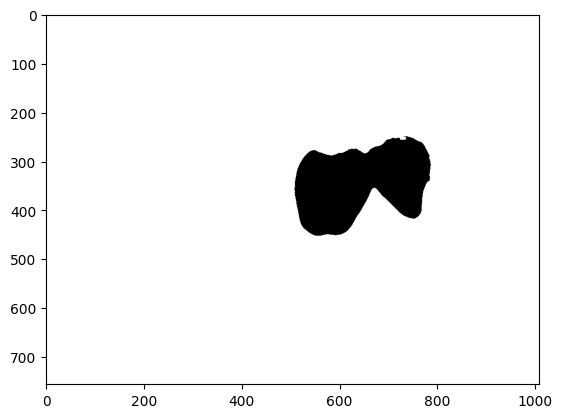

In [92]:
# Aplico un threshold a la imagen 6
img6_bin = cv2.threshold(img6_preprocesada_rojo, 240, 255, cv2.THRESH_BINARY)[1]

plt.imshow(img6_bin, cmap='gray')

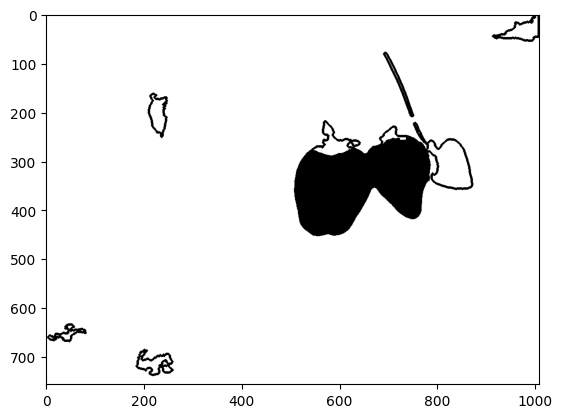

In [93]:
# Haga una copia de la imagen binarizada
img6_bin_copy = img6_bin.copy()

# Dibujar los contornos de la imagen 6 sobre la imagen binarizada
img6_contornos_prepro = cv2.drawContours(img6_bin_copy, fresas6, -1, (0, 255, 0), 3)

plt.imshow(img6_contornos_prepro, cmap='gray')

Notemos que el problema pudo haber sido generado en el punto en el que se tocan las fresas, es posible que haya sido tomado como el mismo contorno, aseguremonos de esto, continuando el proceso

In [95]:
print(len(fresas6))

6


Por una simple revisión podemos ver que nos salen 6 contornos, cuando deberíamos tener 7. Modifiquemos un poco el trehshold para ver si podemos obtener los 7 contornos.

In [96]:
def segmentar_fresas5(img):
    
    # Obtenemos el canal R
    canal_r = img[:,:,2]
    
    # Aplicamos un filtro de mediana
    cr_median = cv2.medianBlur(canal_r, 9)
    
    # Aplicamos un threshold
    img_bin = cv2.threshold(cr_median, 210, 255, cv2.THRESH_BINARY)[1]
    
    # Encontramos los contornos
    contours, _ = cv2.findContours(img_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Inicializa una lista para almacenar las fresas detectadas
    fresas = []
    
    # Filtrar contornos
    for cnt in contours:
        area = cv2.contourArea(cnt)
        
        # Filtrar por área
        if area > 700:  # ajustar según la escala de la imagen
            fresas.append(cnt)
    
    # Creamos una copia de la imagen
    img_copy = img.copy()
    
    # Dibujamos los contornos
    img_contornos = cv2.drawContours(img_copy, fresas, -1, (0, 255, 0), 3)
    
    return img_contornos, fresas

In [97]:
# Probamos la función con la imagen 6
img_segmentada6_final_6_v2, fresas6_final = segmentar_fresas5(img6)

In [98]:
print(len(fresas6_final))

5


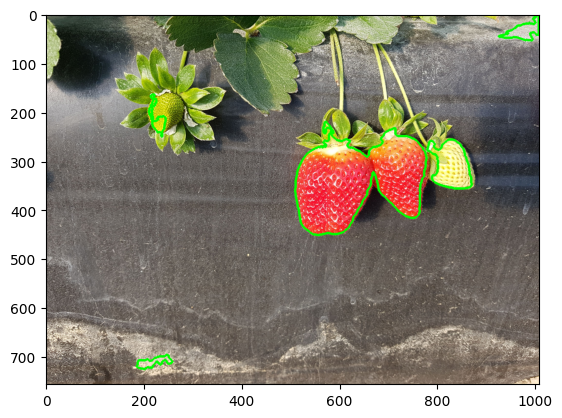

In [99]:
# Ver la imagen segmentada
plt.imshow(cv2.cvtColor(img_segmentada6_final_6_v2, cv2.COLOR_BGR2RGB))


Se eliminaron ciertos contornos que no eran necesarios, pero se logró separar el contorno que necesitabamos. Apliquemos la función de segmentación final a la imagen 6 para ver si ya obtenemos los resultados deseados.

(-0.5, 1007.5, 755.5, -0.5)

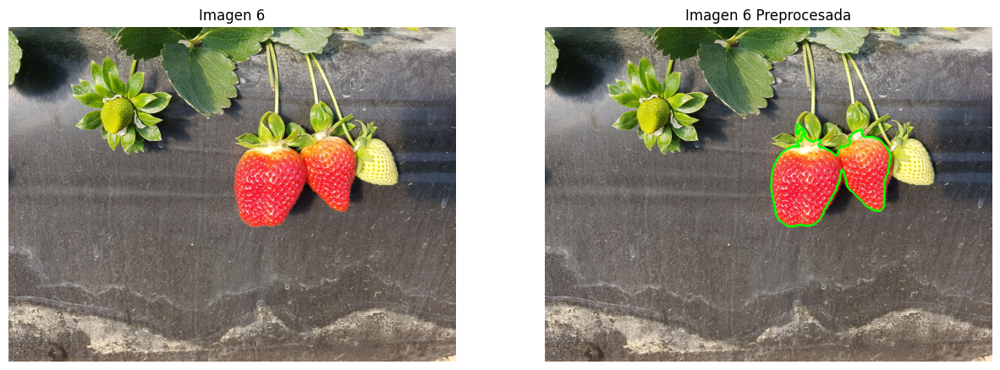

In [100]:
# Aplicar la función a la imagen 6
img6_final_v2 = segmentacion_final(img6, fresas6_final)

# Mostrar los resultados
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 6')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img6_final_v2, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 6 Preprocesada')
axs[1].axis('off')

Ya logramos la segmentación deseada de la imagen 6, probemos a ver si funciona para las otras imágenes de prueba.

In [101]:
# Aplicar la función de los contornos finales a las imágenes
# Probamos la función con la imagen 1  
img_segmentada1_final_v2, fresas1_v2 = segmentar_fresas5(img1)

# Probamos la función con la imagen 2
img_segmentada2_final_v2, fresas2_v2 = segmentar_fresas5(img2)

# Probamos la función con la imagen 3
img_segmentada3_final_v2, fresas3_v2 = segmentar_fresas5(img3)

# Probamos la función con la imagen 4
img_segmentada4_final_v2, fresas4_v2 = segmentar_fresas5(img4)

# Probamos la función con la imagen 5
img_segmentada5_final_v2, fresas5_v2 = segmentar_fresas5(img5)

# Probamos la función con la imagen 6
img_segmentada6_final_v2, fresas6_v2 = segmentar_fresas5(img6)

In [102]:
# Aplicar la función a la imagen 1
img1_final_v2 = segmentacion_final(img1, fresas1_v2)

# Aplicar la función a la imagen 2
img2_final_v2 = segmentacion_final(img2, fresas2_v2)

# Aplicar la función a la imagen 3
img3_final_v2 = segmentacion_final(img3, fresas3_v2)

# Aplicar la función a la imagen 4
img4_final_v2 = segmentacion_final(img4, fresas4_v2)

# Aplicar la función a la imagen 5
img5_final_v2 = segmentacion_final(img5, fresas5_v2)

# Aplicar la función a la imagen 6
img6_final_v2 = segmentacion_final(img6, fresas6_v2)

(-0.5, 1007.5, 755.5, -0.5)

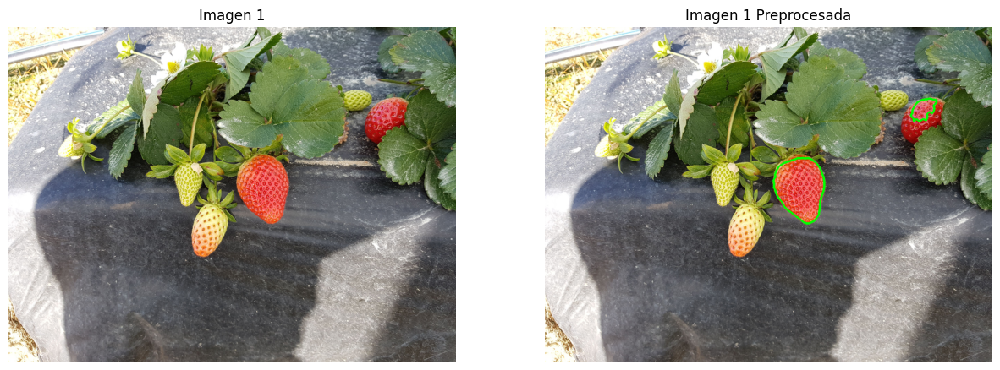

In [103]:
# Mostrar los resultados, imagen por imagen

# Para la imagen 1
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 1')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img1_final_v2, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 1 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

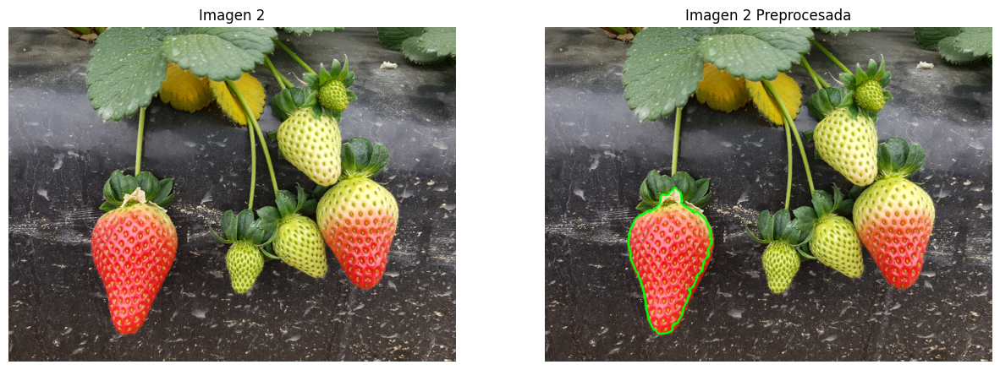

In [104]:
# Para la imagen 2
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 2')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img2_final_v2, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 2 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

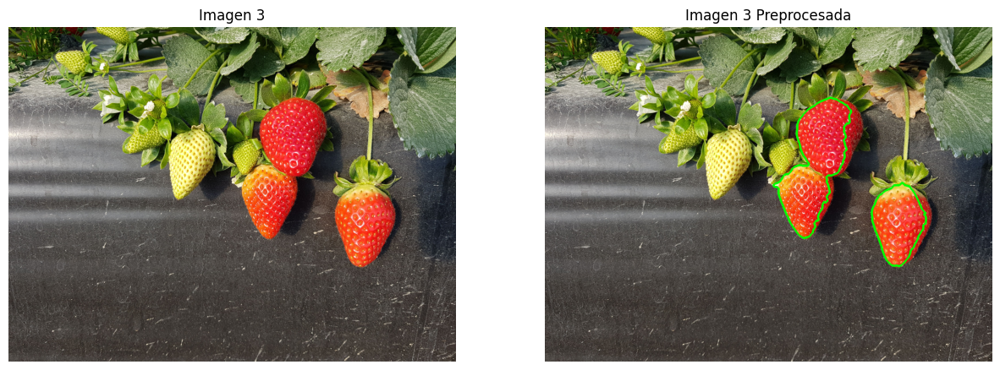

In [105]:
# Para la imagen 3
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 3')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img3_final_v2, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 3 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

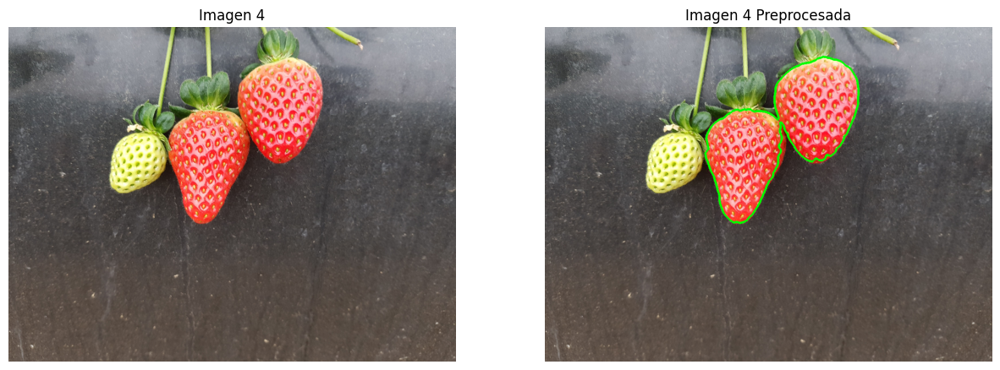

In [106]:
# Para la imagen 4
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 4')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img4_final_v2, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 4 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

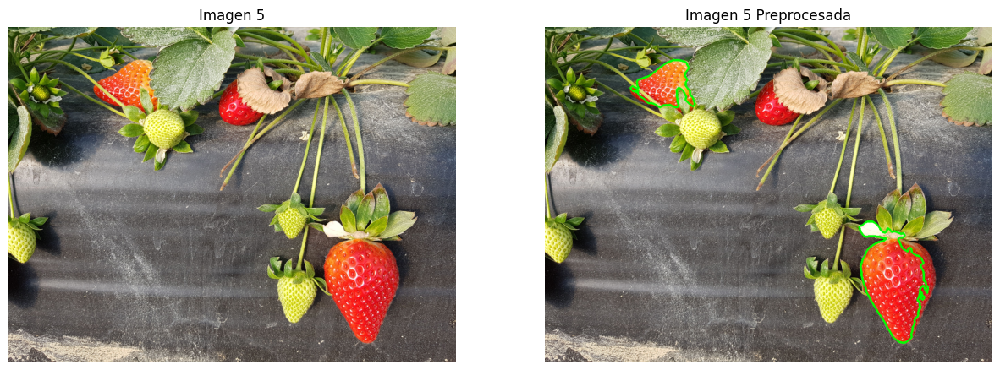

In [107]:
# Para la imagen 5
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img5_final_v2, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 5 Preprocesada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

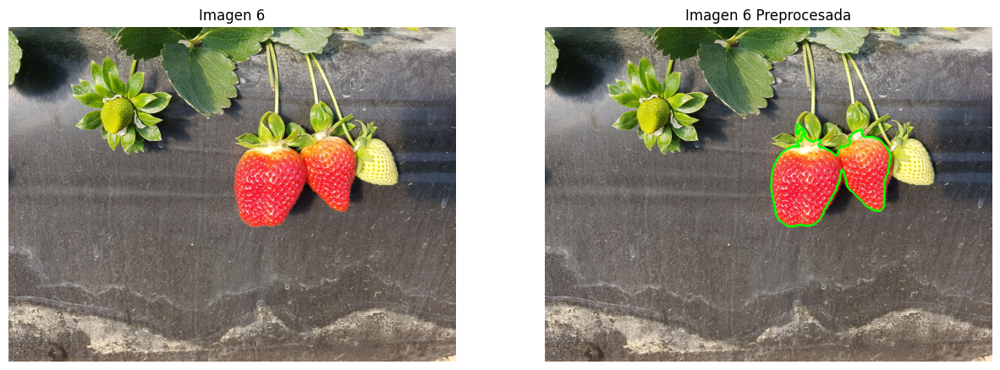

In [108]:
# Para la imagen 6
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 6')
axs[0].axis('off')
axs[1].imshow(cv2.cvtColor(img6_final_v2, cv2.COLOR_BGR2RGB), cmap='gray')
axs[1].set_title('Imagen 6 Preprocesada')
axs[1].axis('off')

Hemos logrado segmentar correctamente las fresas en las imágenes de prueba. Finalmente, condensemos un proceso general en una función para que, dado una imagen, se pueda segmentar las fresas rojas.

In [111]:
def segmentacion_fresas_rojas(img):
    # Convertimos la imagen a RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # PASO 1: Segmentar las fresas de manera algo general
    
    # Obtenemos el canal R
    canal_r = img_rgb[:,:,0]
    
    # Aplicamos un filtro de mediana
    cr_median = cv2.medianBlur(canal_r, 9)
    
    # Aplicamos un threshold
    img_bin = cv2.threshold(cr_median, 210, 255, cv2.THRESH_BINARY)[1]
    
    # Encontramos los contornos
    contours, _ = cv2.findContours(img_bin, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    
    # Inicializa una lista para almacenar las fresas detectadas
    fresas = []
    
    # Filtrar contornos
    for cnt in contours:
        area = cv2.contourArea(cnt)
        
        # Filtrar por área
        if area > 700:  # ajustar según la escala de la imagen
            fresas.append(cnt)
            
    # PASO 2: Segmentar las fresas rojas de manera específica usando preprocesamiento
    
    # Aplicar corrección de gamma
    
    # PASO 2.1: Definir sub funciones para aplicar la transformación sobre la imagen RGB
    def apply_f_on_rgb(img, f, args):
        #Crear una matriz de ceros del tamaño de la imagen de entrada
        res = np.zeros(img.shape, np.uint8)
        #Aplicar la transformación f sobre cada canal del espacio de color RGB
        res[:,:,0] = f(img[:,:,0], *args)
        res[:,:,1] = f(img[:,:,1], *args)
        res[:,:,2] = f(img[:,:,2], *args)

        return res
    
    # Paso 2.2: Aplicar corrección de gamma
    def gamma_correction(img, a, gamma):
        #Crear copia de la imagen tipo flotante dada la normalización
        img_copy = img.copy().astype(np.float32)/255.0
        #La función corrección gamma es de la forma ax^gamma, donde x es la imagen de entrada
        res_gamma = cv2.pow(img_copy,gamma)
        res = cv2.multiply(res_gamma, a)
    
        #Asegurar que la los datos queden entre 0 y 255 y sean uint8
        res[res<0] = 0
        res = res*255.0
        res[res>255] = 255
    
        res = res.astype(np.uint8)
    
        return res
    
    # Paso 2.3: Realizar el preprocesamiento
    
    # Aplicar corrección de gamma
    img_prep_gamma = apply_f_on_rgb(img_rgb, gamma_correction, [1, 1.5])
    
    # Aplicar filtro de mediana
    img_prep_mediana = cv2.medianBlur(img_prep_gamma, 15)
    
    # Aplicar el canal B del espacio LAB
    img_prep_LAB = cv2.cvtColor(img_prep_mediana, cv2.COLOR_BGR2LAB)
    img_prep_B_LAB = img_prep_LAB[:,:,2]
    
    # Aplicar la operación suma para finalizar el preprocesamiento
    img_preprocesada = cv2.add(img_prep_B_LAB, 150)
    
    # Creo el binarizado de la imagen preprocesada
    img_bin = cv2.threshold(img_preprocesada, 240, 255, cv2.THRESH_BINARY)[1]
    
    # Lista para almacenar los contornos que cumplen con el criterio
    cont_filtrados = []
    
    for cont in fresas:
        mask = np.zeros_like(img_bin)
    
        cv2.drawContours(mask, [cont], -1, 255, thickness=cv2.FILLED)
        
        inv_mask = cv2.bitwise_not(mask)
        
        # Extraer los píxeles en la región del contorno
        region_pixeada = cv2.bitwise_or(img_bin, inv_mask)
        
        # Primero obtengo la inversa de la ultima mascara
        inv_regpix = cv2.bitwise_not(region_pixeada)
        
        # Ahora si, realizo la cuenta
        pix_gen = cv2.countNonZero(mask)
        pix_roj = cv2.countNonZero(inv_regpix)
        
        # Calcular el porcentaje de píxeles negros
        porcentaje_negro = (pix_roj / pix_gen) * 100 if pix_gen > 0 else 0
        
        # Si el porcentaje de píxeles negros es mayor al 80%, añadir a la lista
        if porcentaje_negro > 80:
            cont_filtrados.append(cont)
            
    # Creo una copia de la imagen para dibujarle los contornos
    img_copy = img_rgb.copy()
    
    # Dibujar los contornos de la imagen 1 sobre la imagen preprocesada
    img_final = cv2.drawContours(img_copy, cont_filtrados, -1, (0, 255, 0), 3)

    return img_final

In [112]:
# Aplico la función de segmentación de las fresas

# Imagen 1
img1_roja = segmentacion_fresas_rojas(img1)

# Imagen 2
img2_roja = segmentacion_fresas_rojas(img2)

# Imagen 3
img3_roja = segmentacion_fresas_rojas(img3)

# Imagen 4
img4_roja = segmentacion_fresas_rojas(img4)

# Imagen 5
img5_roja = segmentacion_fresas_rojas(img5)

# Imagen 6
img6_roja = segmentacion_fresas_rojas(img6)

(-0.5, 1007.5, 755.5, -0.5)

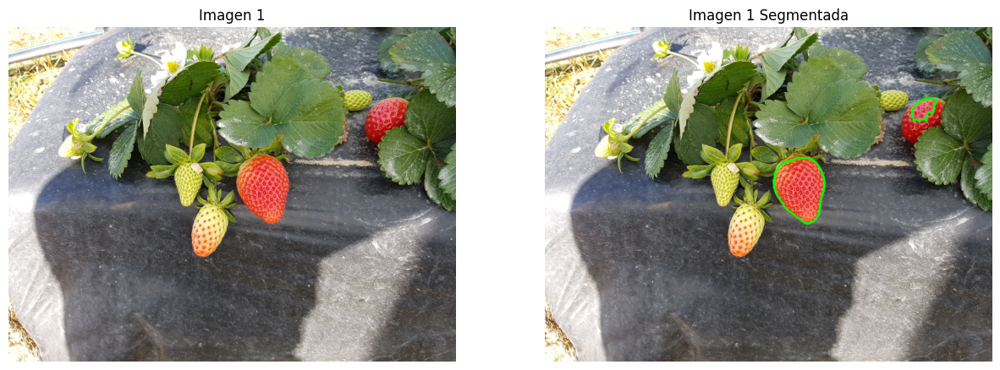

In [113]:
# Mostrar los resultados

# Para la imagen 1
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img1, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 1')
axs[0].axis('off')
axs[1].imshow(img1_roja, cmap='gray')
axs[1].set_title('Imagen 1 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

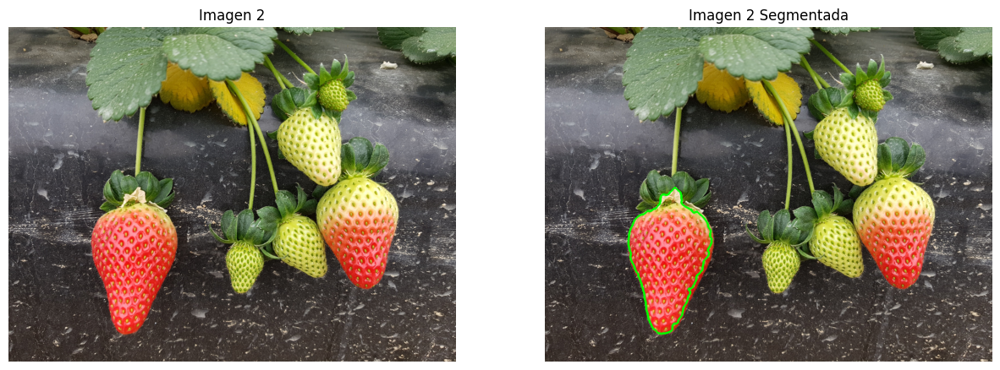

In [114]:
# Para la imagen 2
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img2, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 2')
axs[0].axis('off')
axs[1].imshow(img2_roja, cmap='gray')
axs[1].set_title('Imagen 2 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

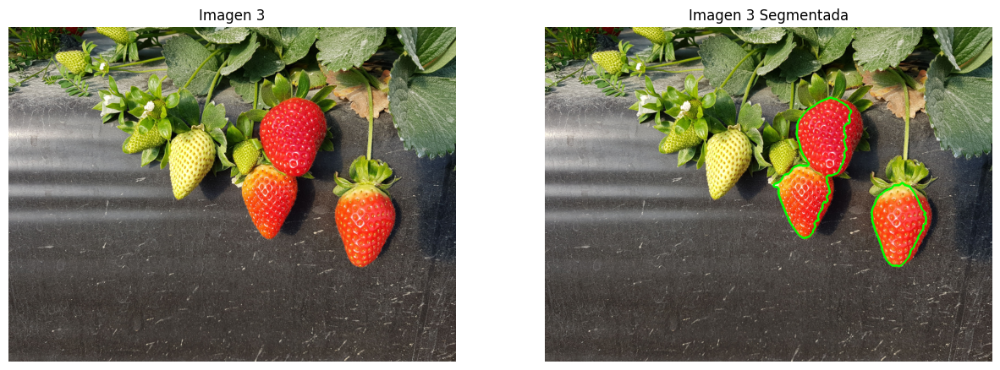

In [115]:
# Para la imagen 3
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img3, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 3')
axs[0].axis('off')
axs[1].imshow(img3_roja, cmap='gray')
axs[1].set_title('Imagen 3 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

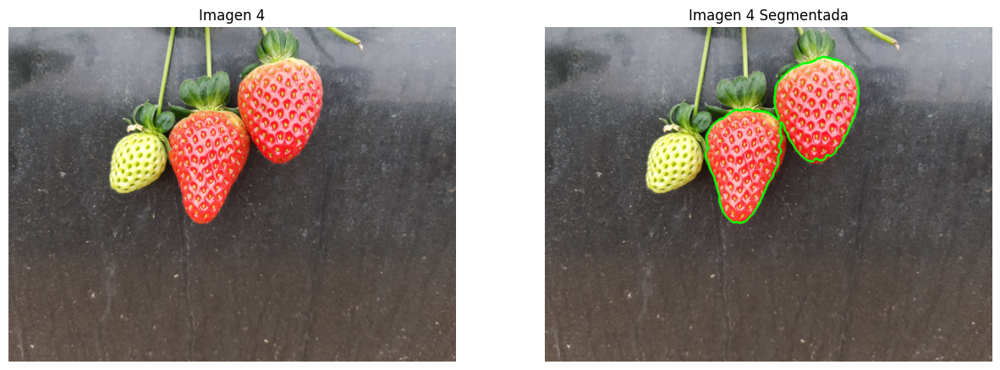

In [116]:
# Para la imagen 4
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img4, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 4')
axs[0].axis('off')
axs[1].imshow(img4_roja, cmap='gray')
axs[1].set_title('Imagen 4 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

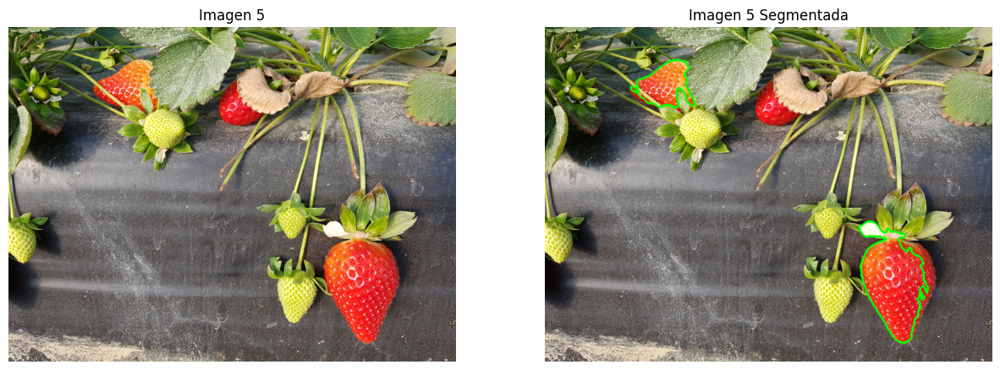

In [117]:
# Para la imagen 5
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img5, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 5')
axs[0].axis('off')
axs[1].imshow(img5_roja, cmap='gray')
axs[1].set_title('Imagen 5 Segmentada')
axs[1].axis('off')

(-0.5, 1007.5, 755.5, -0.5)

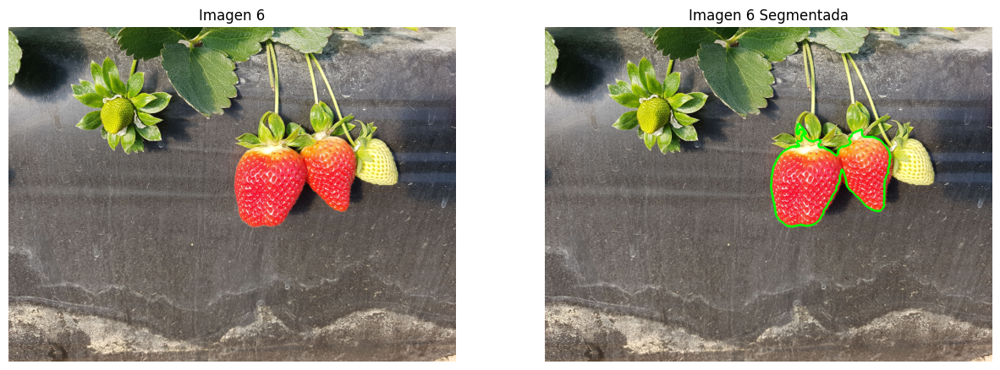

In [118]:
# Para la imagen 6
fig, axs = plt.subplots(1, 2, figsize=(15, 10))

axs[0].imshow(cv2.cvtColor(img6, cv2.COLOR_BGR2RGB))
axs[0].set_title('Imagen 6')
axs[0].axis('off')
axs[1].imshow(img6_roja, cmap='gray')
axs[1].set_title('Imagen 6 Segmentada')
axs[1].axis('off')